# Introduction 
We have analysed two datasets:  NYC Citywide Annualized Calendar Sales Update and NYPD Arrest Data (Year to Date), both  from NYC OpenData. On top of that, we have gathered Geographical data to visualize maps for better overview.

### The structure of our notebook
As we first work with two datasets separately, first the housing data and then the arrest data. Which we in the end combine to perform machine learning on it. 
We needed to perform the analysis on each data set separately as out computer could not handle the combined data of both set. After each dataset is there a small conclusion on what information we have gathered. Then at the bottom of the notebook is the conclusion for the entire analysis placed.  



## Motivation 
By analyzing New York City's housing transaction records, including home prices, areas, square footage, and types of homes, we explore the patterns of real estate transactions, as well as combining New York City's crime records to find safer areas to live in and provide sound recommendations for people looking to buy a house.


## Genre 
We have chosen to use an interactive slideshow as it allows us to have a clear story line but still let the reader explore deeper into the interesting patterns we found.  
To ensure the reader can maintain an overview of the story line a progress bar is used in the form of the slide numbers. So one can see which slide number one is on and how much is left. If the reader wants to get a snapshot of all the slides, the person can click on the slide tracker. With each new information is highlighted by the scrolling and moving to a new slide.  
For the structure of the information then we used a linear path defined by the slides. 
We have used many different interactive tools to highlight our findings. We have used hover highlighting for details and filtering in the maps. As there both can be a lot of information in a  plot then it is easier to see the patterns if there are fewer points. Also if one wants to see more information of one part then one can either hover over a part or click on a marker to see more information.  As it also can see too much if the reader always has to do something to get information then we also used plots without interactions. To ensure the reader always knows if they can gain more information then it is written in the text. 
To ensure that our message comes across to the reader we have used different methods as captions, introduction text, comments and summary. 


##Visualization
We mainly use four kinds of visualizations: bar charts, histograms, boxplots and choropleth maps. The purpose of these visualization methods was to gain an overview of the patterns. As we use many variables that connect with geological areas, then one can better understand if it is plotted on the map. It also makes it possible to give more details on demand as the reader can hover or click on the plotted data to gain more insight in the patterns if interested. Bar charts and histograms give an easy overview of the distribution in the data.  

#### Imports 

In [ ]:
import pandas as pd
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
import folium
from folium import plugins
from folium.plugins import HeatMap
from urllib.request import urlopen
import json
import seaborn as sns
from bokeh.io import output_file, show
from bokeh.plotting import figure
from bokeh.models import ColumnDataSource, FactorRange, Legend
from bokeh.palettes import Category10, Category20, Category20b, Category20c 
from bokeh.models import ColumnDataSource, HoverTool, Panel
from bokeh.plotting import ColumnDataSource, figure, output_file, show, reset_output, output_notebook
from sklearn import preprocessing
import warnings
warnings.filterwarnings('ignore')
from sklearn.cluster import AgglomerativeClustering, KMeans
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
import plotly.express as px
# import geopandas as gpd

## Housing Data 

This section contains the basic statistic of the data, this is done to gain insight in the patterns in each of the data columns. This housing data contains prices, dates, zip codes and coordinates which are the main focus in this projects 

In [ ]:
# import data:
Housedata=pd.read_csv("NYC_Citywide_Annualized_Calendar_Sales_Update.csv")

# format the date-time
Housedata['SALE DATE']=pd.to_datetime(Housedata['SALE DATE'],infer_datetime_format=True)
Housedata.head()

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AS OF FINAL ROLL,BLOCK,LOT,EASE-MENT,BUILDING CLASS AS OF FINAL ROLL,ADDRESS,APARTMENT NUMBER,...,SALE PRICE,SALE DATE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA
0,1,CHELSEA,21 OFFICE BUILDINGS,4,697,5,NaN,O2,555 WEST 25TH STREET,NaN,...,43300000,2019-03-28,40.749704,-74.004930,104.0,3.0,99.0,1012379.0,1.006970e+09,Hudson Yards-Chelsea-Flatiron-Union Square
1,1,CHELSEA,21 OFFICE BUILDINGS,4,697,23,NaN,O6,511 WEST 25TH STREET,NaN,...,148254147,2019-05-23,40.749364,-74.004132,104.0,3.0,99.0,1012382.0,1.006970e+09,Hudson Yards-Chelsea-Flatiron-Union Square
2,1,CHELSEA,21 OFFICE BUILDINGS,4,700,55,NaN,O2,538 WEST 29TH STREET,NaN,...,11000000,2019-03-13,40.752067,-74.002931,104.0,3.0,99.0,1012435.0,1.007000e+09,Hudson Yards-Chelsea-Flatiron-Union Square
3,1,CHELSEA,21 OFFICE BUILDINGS,4,712,1,NaN,O6,450 WEST 15TH,NaN,...,591800000,2019-05-22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,CHELSEA,21 OFFICE BUILDINGS,4,746,64,NaN,O8,340 WEST 23RD STREET,NaN,...,0,2019-04-01,40.745809,-73.999729,104.0,3.0,93.0,1013367.0,1.007460e+09,Hudson Yards-Chelsea-Flatiron-Union Square



#### Data processing: 
The bourughs are encoded as integers, we are interested in converting them to strings.

In [ ]:
Housedata['BOROUGH'] = ['MANHATTAN' if row==1 else row for row in Housedata['BOROUGH']]
Housedata['BOROUGH'] = ['BRONX' if row==2 else row for row in Housedata['BOROUGH']]
Housedata['BOROUGH'] = ['BROOKLYN' if row==3 else row for row in Housedata['BOROUGH']]
Housedata['BOROUGH'] = ['QUEENS' if row==4 else row for row in Housedata['BOROUGH']]
Housedata['BOROUGH'] = ['RICHMOND / STATEN ISLAND' if row==5 else row for row in Housedata['BOROUGH']]

Take a look at number of records in each borough of the dataset.

Text(0, 0.5, 'Counts')

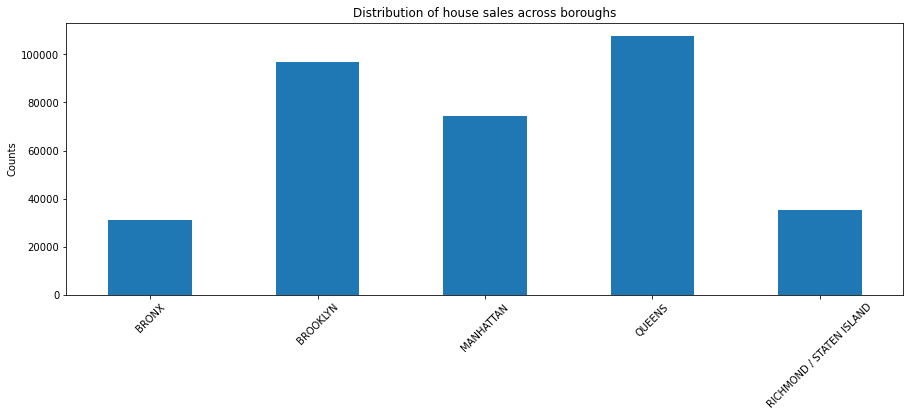

In [ ]:
ax=Housedata['BOROUGH'].value_counts().sort_index().plot(kind='bar', 
                                                         rot=45, figsize= (15,5), 
                                                         title='Distribution of house sales across boroughs')
ax.set_ylabel('Counts')

#### Distribution across boroughs
The distribution of the data across the boroughs is showing in the bar chart as a bar chart is easy to see the distribution on. As shown here, Queens and Brooklyn are the boroughs that have the most house sales in this data set.

#### The outliers affects the data a lot
Therefore we are interested in more data processing:

In [ ]:
# Removing outliers of the zip codes within NY.
Housedata = Housedata[Housedata["ZIP CODE"]>0]
Housedata = Housedata[Housedata["SALE PRICE"]>200]

Text(0.5, 1.0, 'Price distribution with outliers')

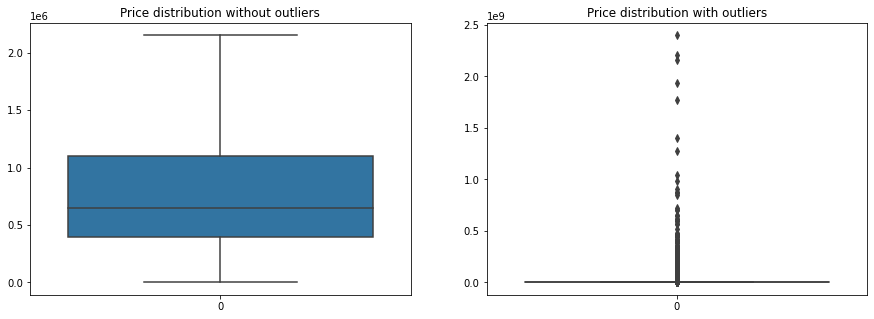

In [ ]:
fig, axes = plt.subplots(1, 2, sharex=True, figsize=(15,5))
sns.boxplot(ax=axes[0],data=Housedata["SALE PRICE"],showfliers = False)
sns.boxplot(ax=axes[1],data=Housedata["SALE PRICE"])
axes[0].set_title('Price distribution without outliers')
axes[1].set_title('Price distribution with outliers')

In the boxplot to the left can we see that there are many outliers that affect the price range a lot. To the plot on the left we have removed the outliers and most prices lies below 2.5 mio dollars.  

We can see from the boxplot that there are many outliers, in order to see the distribution of the prices occurring then we plot a histogram and a kde plot.

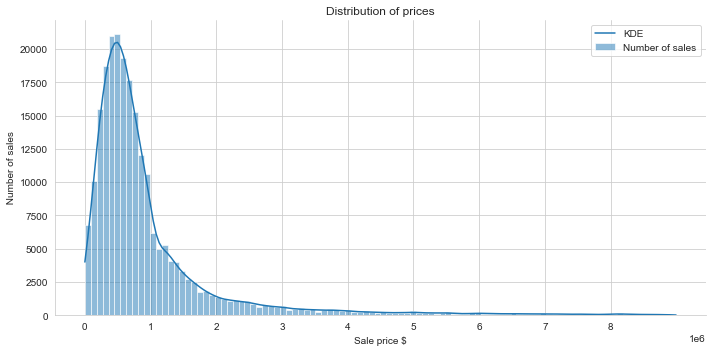

In [ ]:
sns.set_style("whitegrid")
sns.displot(Housedata[(Housedata['SALE PRICE']<9000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'], 
             kde=True, bins=100, height=5, aspect=2,legend=True).set(xlabel="Sale price $", ylabel = " Number of sales")
plt.xticks(np.arange(0,9*10**6,10**6))
plt.legend(['KDE','Number of sales'])
plt.title('Distribution of prices')
plt.tight_layout()
plt.savefig("histogram_price.png")

In [ ]:
total_num = Housedata[(Housedata['SALE PRICE']<9000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
under_2_mio = Housedata[(Housedata['SALE PRICE']<2000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
print(f'{under_2_mio/total_num*100:.2f}% of the houses shown in figure above, are under {2} million $')

90.09% of the houses shown in figure above, are under 2 million $


### Outliers in the prices:
As showing in both boxplots and histogram with kernel density graph. The prices are most frequent within 4 million dollars. Whereas this plot only shows up to 9 million as the outliers are mostly located in the higher price ranges (shown in boxplot) 
The distribution of sale prices shows a normal distribution with a right tail. 

In [ ]:
over_price = 8000000
price_percent= Housedata[(Housedata['SALE PRICE']>over_price)].shape[0]/Housedata.shape[0]*100
print(f'From this point on, house prices that exceeds {over_price} dollars will be removed')
print(f'The fraction of data removed is {price_percent:.2f} %')

From this point on, house prices that exceeds 8000000 dollars will be removed
The fraction of data removed is 2.34 %


In [ ]:
total_num = Housedata[(Housedata['BOROUGH'] == "BROOKLYN") & (Housedata['SALE PRICE']<9000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
under_2_mio = Housedata[(Housedata['BOROUGH'] == "BROOKLYN") & (Housedata['SALE PRICE']<2000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
print(f'{under_2_mio/total_num*100:.2f}% of the houses shown in Brooklyn, are under {2} million $')

total_num = Housedata[(Housedata['BOROUGH'] == "MANHATTAN") & (Housedata['SALE PRICE']<9000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
under_2_mio = Housedata[(Housedata['BOROUGH'] == "MANHATTAN") & (Housedata['SALE PRICE']<2000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
print(f'{under_2_mio/total_num*100:.2f}% of the houses shown in MANHATTAN, are under {2} million $')

total_num = Housedata[(Housedata['BOROUGH'] == "BRONX") & (Housedata['SALE PRICE']<9000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
under_2_mio = Housedata[(Housedata['BOROUGH'] == "BRONX") & (Housedata['SALE PRICE']<2000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
print(f'{under_2_mio/total_num*100:.2f}% of the houses shown in Bronx, are under {2} million $')

total_num = Housedata[(Housedata['BOROUGH'] == "QUEENS") & (Housedata['SALE PRICE']<9000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
under_2_mio = Housedata[(Housedata['BOROUGH'] == "QUEENS") & (Housedata['SALE PRICE']<2000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
print(f'{under_2_mio/total_num*100:.2f}% of the houses in Queens, are under {2} million $')

total_num = Housedata[(Housedata['BOROUGH'] == "RICHMOND / STATEN ISLAND") & (Housedata['SALE PRICE']<9000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
under_2_mio = Housedata[(Housedata['BOROUGH'] == "RICHMOND / STATEN ISLAND") & (Housedata['SALE PRICE']<2000000) & (Housedata['SALE PRICE']>200)]['SALE PRICE'].shape[0]
print(f'{under_2_mio/total_num*100:.2f}% of the houses shown in Richmond / Staten Island, are under {2} million $')


89.94% of the houses shown in Brooklyn, are under 2 million $
74.12% of the houses shown in MANHATTAN, are under 2 million $
95.49% of the houses shown in Bronx, are under 2 million $
97.63% of the houses in Queens, are under 2 million $
99.35% of the houses shown in Richmond / Staten Island, are under 2 million $


In [ ]:
## Data processing to get correct data into bins:
from bokeh.plotting import figure, output_file, save

#NoOutlier = Housedata[(Housedata['SALE PRICE']>over_price)]

max_out= 5000000
min_out = 100000
NoOutlier = Housedata[(Housedata['SALE PRICE']<max_out) & (Housedata['SALE PRICE']>min_out)] 


list_of_borough = Housedata['BOROUGH'].unique()
HistData={}
for indx,i in enumerate(list_of_borough):
    bins = 50 
    dataframe=NoOutlier[NoOutlier['BOROUGH']==i]
    column = 'SALE PRICE'

    hist, edges = np.histogram(dataframe[column], bins = bins)
    hist_df = pd.DataFrame({column: hist,
                        "left": edges[:-1],
                        "right": edges[1:]})
    hist_df["interval"] = ["%d to %d" % (left, right) for left, 
                           right in zip(hist_df["left"], hist_df["right"])]
    
    
    HistData[i]=ColumnDataSource(hist_df)
    
    
# create plot 
reset_output()
output_notebook()

# initialize standard settings for the plot: 
plot = figure(plot_height = 300, plot_width = 700, title = 'House prices in New York',
      x_axis_label = 'USD',
      y_axis_label = "Count")  

# Create empty dictionary for bars
bar={}
# create empty legend list
legend_it = []

# define colors for the boroughs
colors = Category10[len(list_of_borough)]

for indx,i in enumerate(list_of_borough):
    src = HistData[i]
    
    bar[i]=plot.quad(top=column, bottom=0.1, left = "left", right = "right",
                       source=src, color=colors[indx], muted_alpha=0.2,muted=True , legend_label = i) 
    
    
    #legend_it.append((i, [bar[i]]))

#legend = Legend(items=legend_it)
#legend.click_policy="mute"
#plot.add_layout(legend, 'right')

plot.legend.location = "top_right"
plot.legend.click_policy="hide"


#displays plot:
show(plot) 

output_file("bokeh_prices.html")
save(plot)

Loading BokehJS ...

'/Users/jiayihan/OneDrive - Danmarks Tekniske Universitet/Social_data_project/bokeh_prices.html'

#### The distribution of prices across boroughs
For the purpose of visualization, the data has been fitlered, as most of the data will be located in the left side.
The plot here shows that queens has the most house sales in the lower price ranges
Whereas comparing Manhattan and Queens, the prices above 1mio dollars will most likely belong to Manhattan. 

Findings:
- Manhattan and Brooklyn tend to have similar profiles
- Richmond/staten Island is similar to Bronx. 


In [ ]:
Housedata.loc[Housedata['SALE PRICE']< 10**6 , 'Price'] = 'Below 1 mio'
Housedata.loc[((Housedata['SALE PRICE'] >= 10**6) & (Housedata['SALE PRICE'] < 2*10**6)) , 'Price'] = '1-2 mio'
Housedata.loc[((Housedata['SALE PRICE'] >= 2*10**6) & (Housedata['SALE PRICE'] < 3*10**6)) , 'Price'] = '2-3 mio'
Housedata.loc[((Housedata['SALE PRICE'] >= 3*10**6) & (Housedata['SALE PRICE'] < 4*10**6)) , 'Price'] = '3-4 mio'
Housedata.loc[(Housedata['SALE PRICE'] >= 4*10**6)  , 'Price'] = 'Above 4 mio'

# Ensure you're handing it floats
Housedata['Latitude'] = Housedata['Latitude'].astype(float)
Housedata['Longitude'] = Housedata['Longitude'].astype(float)

House = Housedata[(pd.DatetimeIndex(Housedata['SALE DATE']).year == 2019)]
House['text'] = House.apply(lambda row: 'Sale price: ' + str(row['SALE PRICE']), axis=1)

<ipython-input-8-ca604c5f2f66>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  House['text'] = House.apply(lambda row: 'Sale price: ' + str(row['SALE PRICE']), axis=1)


In [ ]:
map_hooray = folium.Map(location=[40.693943, -73.985880], zoom_start=10)
# The choropleth map for the borough outline 
folium.Choropleth(geo_data='Boroughs.geojson', 
             key_on='feature.properties.borough', 
             fill_color='YlGn', fill_opacity=0, line_opacity=1, width = 3 ,color = 'black', name = 'Borough outline').add_to(map_hooray)


callback = ('function (row) {' 
            'var marker = L.marker(new L.LatLng(row[0], row[1]), {color: "red"});'
            'var icon = L.AwesomeMarkers.icon({'
            "icon: 'map-marker',"
            "iconColor: 'white',"
            "markerColor: 'blue',"
            "prefix: 'glyphicon',"
            "extraClasses: 'fa-rotate-0'"
                '});'
            'marker.setIcon(icon);'
            "var popup = L.popup({maxWidth: '300'});"
            "const display_text = {text: row[2]};"
            "var mytext = $(`<div id='mytext' class='display_text' style='width: 100.0%; height: 100.0%;'> ${display_text.text}</div>`)[0];"
            "popup.setContent(mytext);"
            "marker.bindPopup(popup);"
            'return marker};')


House_b = House[House['Price'] == 'Below 1 mio'].dropna(axis=0, subset=['Latitude','Longitude'])
plugins.FastMarkerCluster(House_b[['Latitude', 'Longitude', 'text']],  callback=callback, name = 'Below 1 mio').add_to(map_hooray)

callback = ('function (row) {' 
            'var marker = L.marker(new L.LatLng(row[0], row[1]), {color: "red"});'
            'var icon = L.AwesomeMarkers.icon({'
            "icon: 'map-marker',"
            "iconColor: 'white',"
            "markerColor: 'green',"
            "prefix: 'glyphicon',"
            "extraClasses: 'fa-rotate-0'"
                '});'
            'marker.setIcon(icon);'
            "var popup = L.popup({maxWidth: '300'});"
            "const display_text = {text: row[2]};"
            "var mytext = $(`<div id='mytext' class='display_text' style='width: 100.0%; height: 100.0%;'> ${display_text.text}</div>`)[0];"
            "popup.setContent(mytext);"
            "marker.bindPopup(popup);"
            'return marker};')

House_b = House[House['Price'] == '1-2 mio'].dropna(axis=0, subset=['Latitude','Longitude'])
plugins.FastMarkerCluster(House_b[['Latitude', 'Longitude', 'text']],  callback=callback, name = '1-2 mio').add_to(map_hooray)

callback = ('function (row) {' 
            'var marker = L.marker(new L.LatLng(row[0], row[1]), {color: "red"});'
            'var icon = L.AwesomeMarkers.icon({'
            "icon: 'map-marker',"
            "iconColor: 'white',"
            "markerColor: 'orange',"
            "prefix: 'glyphicon',"
            "extraClasses: 'fa-rotate-0'"
                '});'
            'marker.setIcon(icon);'
            "var popup = L.popup({maxWidth: '300'});"
            "const display_text = {text: row[2]};"
            "var mytext = $(`<div id='mytext' class='display_text' style='width: 100.0%; height: 100.0%;'> ${display_text.text}</div>`)[0];"
            "popup.setContent(mytext);"
            "marker.bindPopup(popup);"
            'return marker};')

House_b = House[House['Price'] == '2-3 mio'].dropna(axis=0, subset=['Latitude','Longitude'])
plugins.FastMarkerCluster(House_b[['Latitude', 'Longitude', 'text']], callback=callback, name = '2-3 mio', show = False).add_to(map_hooray)

callback = ('function (row) {' 
            'var marker = L.marker(new L.LatLng(row[0], row[1]), {color: "red"});'
            'var icon = L.AwesomeMarkers.icon({'
            "icon: 'map-marker',"
            "iconColor: 'white',"
            "markerColor: 'red',"
            "prefix: 'glyphicon',"
            "extraClasses: 'fa-rotate-0'"
                '});'
            'marker.setIcon(icon);'
            "var popup = L.popup({maxWidth: '300'});"
            "const display_text = {text: row[2]};"
            "var mytext = $(`<div id='mytext' class='display_text' style='width: 100.0%; height: 100.0%;'> ${display_text.text}</div>`)[0];"
            "popup.setContent(mytext);"
            "marker.bindPopup(popup);"
            'return marker};')


House_b = House[House['Price'] == 'Above 4 mio'].dropna(axis=0, subset=['Latitude','Longitude'])
plugins.FastMarkerCluster(House_b[['Latitude', 'Longitude', 'text']], callback=callback, name = 'Above 4 mio', show = False).add_to(map_hooray)
, 


folium.LayerControl().add_to(map_hooray)

map_hooray

In [ ]:
map_hooray.save("map_NYC_prices.html")½

We chose to show all the sales as a cluster marker map as the reader can filter in which data to see. Also one can click on it on the marker to see the exact sale price. The cluster map is an easy way to see where the house sale happens as for example can it be seen that most sales above 4 mio dolalrs happens om Manhattan. 

### Interesting to look at building types 

As it originally contains more than 90 different catogories we have decided to group them into following classes as visualized in the bar chart

In [ ]:
Housedata['BUILDING CLASS CATEGORY'] = ['OFFICE' if 'OFFICE' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['APPARTMENT' if 'APARTMENTS' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['STORAGE' if 'STORAGE' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['FACILITIES' if 'FACILITIES' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['CONDO' if 'CONDO' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['HOTELS' if 'HOTELS' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['GARAGES' if 'GARAGES' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['VACANT LAND' if 'VACANT LAND' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['ASYLUMS AND HOMES' if 'ASYLUMS AND HOMES' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['LOFT BUILDINGS' if 'LOFT BUILDINGS' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['WAREHOUSES' if 'WAREHOUSES' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['FAMILY DWELLINGS' if 'FAMILY DWELLINGS' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['FACTORIES' if 'FACTORIES' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['STORE BUILDINGS' if 'STORE BUILDINGS' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['OTHER' if 'OTHER' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['RENTALS' if 'RENTALS - 4-10 UNIT' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]
Housedata['BUILDING CLASS CATEGORY'] = ['THEATRES' if 'THEATRES' in row  else row for row in Housedata['BUILDING CLASS CATEGORY']]

Text(0, 0.5, 'Counts')

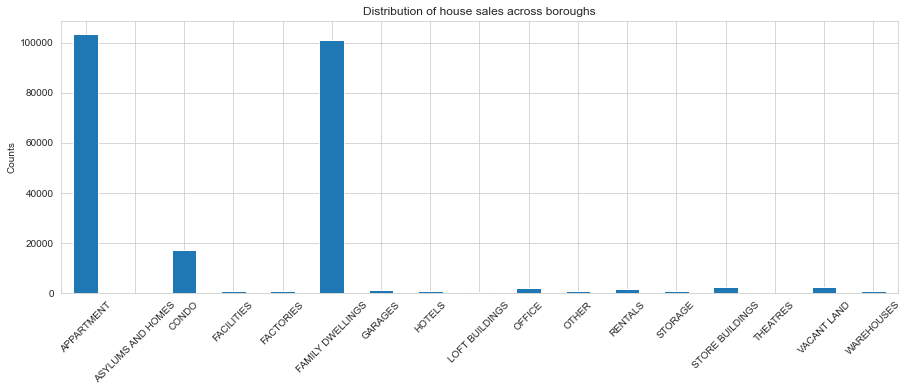

In [ ]:
ax=Housedata['BUILDING CLASS CATEGORY'].value_counts().sort_index().plot(kind='bar', 
                                                         rot=45, figsize= (15,5), 
                                                         title='Distribution of house sales across boroughs')
ax.set_ylabel('Counts')

`apartment` and `family dwellings` make up the majority of the housing sales market, and both have an equal share, far exceeding other housing types.

In [ ]:
## Data processing to get correct data into bins:
from bokeh.plotting import figure, output_file, save

#NoOutlier = Housedata[(Housedata['SALE PRICE']>over_price)]

max_out= 8000000
min_out = 100

NoOutlier = Housedata[(Housedata['SALE PRICE']<max_out) & (Housedata['SALE PRICE']>min_out)] 
focus_types = ['APPARTMENT','FAMILY DWELLINGS']

list_of_classes =NoOutlier[NoOutlier['BUILDING CLASS CATEGORY'].isin(focus_types)]['BUILDING CLASS CATEGORY'].unique()


HistData={}
for indx,i in enumerate(list_of_classes):
    bins = 50 
    dataframe=NoOutlier[NoOutlier['BUILDING CLASS CATEGORY']==i]
    column = 'SALE PRICE'

    hist, edges = np.histogram(dataframe[column], bins = bins)
    hist_df = pd.DataFrame({column: hist,
                        "left": edges[:-1],
                        "right": edges[1:]})
    hist_df["interval"] = ["%d to %d" % (left, right) for left, 
                           right in zip(hist_df["left"], hist_df["right"])]
    
    
    HistData[i]=ColumnDataSource(hist_df)
    
    
# create plot 
reset_output()
output_notebook()

# initialize standard settings for the plot: 
plot = figure(plot_height = 400, plot_width = 700, title = 'House SALE PRICE in New York',
      x_axis_label = 'USD',
      y_axis_label = "Count")  

# Create empty dictionary for bars
bar={}
# create empty legend list
legend_it = []

# define colors for the boroughs
colors = Category20[len(list_of_classes)+3]

for indx,i in enumerate(list_of_classes):
    src = HistData[i]
    
    bar[i]=plot.quad(top=column, bottom=0.1, left = "left", right = "right",
                       source=src, color=colors[indx+1], muted_alpha=0.2,muted=True, legend_label = i) 
    
    
    #legend_it.append((i, [bar[i]]))

#legend = Legend(items=legend_it)
#legend.click_policy="mute"
#plot.add_layout(legend, 'right')

#plot.legend.location = "top_right"
plot.legend.click_policy="hide"


#displays plot:
show(plot) 

output_file("bokeh_prices_types.html")
save(plot)

Loading BokehJS ...

'/Users/jiayihan/OneDrive - Danmarks Tekniske Universitet/Social_data_project/bokeh_prices_types.html'

#### Histogram of the prices in different types of buildings 
This does plot shows that there is clear differentiation between the different types with regards to the price. The price range of apartment is relatively wider, while the prices of family dwellings are more concentrated.

### Price vs. Size of land

It could be interesting to investigate the size of land you will get for the money in New York. First we need to remove artifacts and only look at the familiy dwellings and apartments. 

In [ ]:
# removing string artifacts like "-"
Housedata=Housedata[(Housedata['GROSS SQUARE FEET'].str.contains('- 0')==False)]                     
Housedata['GROSS SQUARE FEET'] = [float(row.replace(',','')) if type(row)==str else row for row in Housedata['GROSS SQUARE FEET']]

Housedata=Housedata[(Housedata['LAND SQUARE FEET'].str.contains('- 0')==False)]                     
Housedata['LAND SQUARE FEET'] = [float(row.replace(',','')) if type(row)==str else row for row in Housedata['LAND SQUARE FEET']]

In [ ]:
# the focus type in this investigation is family dwellings as apartment (the other category do not have any land)
focus_types = ['FAMILY DWELLINGS','APARTMENT']
DA_out = Housedata[Housedata['BUILDING CLASS CATEGORY'].isin(focus_types)]

In [ ]:
# not considering outlier prices in this plot due to visualization purpose
DA_out=DA_out[(DA_out['SALE PRICE']<4000000) 
              & (DA_out['LAND SQUARE FEET']>0) 
              & (DA_out['LAND SQUARE FEET']<40000)]

<AxesSubplot:xlabel='LAND SQUARE FEET', ylabel='SALE PRICE'>

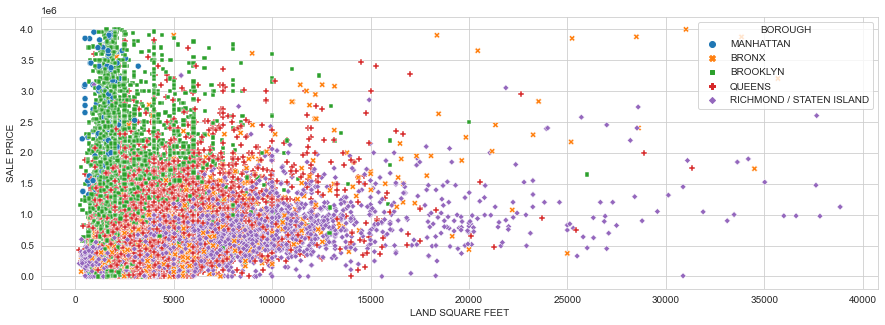

In [ ]:
fig, ax = plt.subplots(figsize=(15,5))
sns.scatterplot(data=DA_out, x='LAND SQUARE FEET', y='SALE PRICE', hue='BOROUGH',style='BOROUGH')

<AxesSubplot:xlabel='GROSS SQUARE FEET', ylabel='SALE PRICE'>

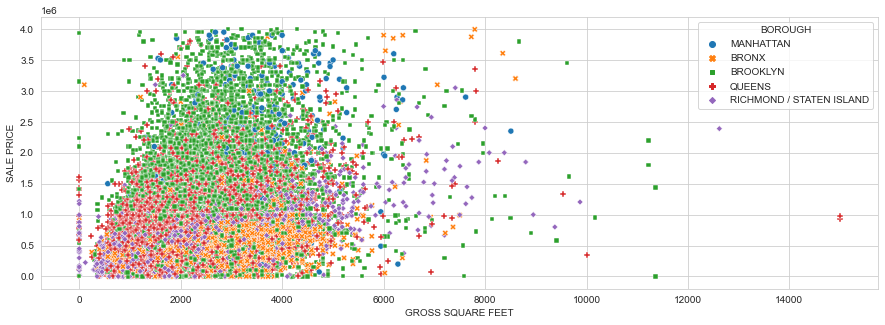

In [ ]:
fig, ax = plt.subplots(figsize=(15,5))
sns.scatterplot(data=DA_out, x='GROSS SQUARE FEET', y='SALE PRICE', hue='BOROUGH',style='BOROUGH')

#### Scatterplot 
This scatterplot shows the distribution of land square feet of the family drewllings. 
And as shown the data indicates if family wants to keep the prices low, and want have large outdoor land, Queens is the way to go. Where as Manhattan and Brooklyn  (opposite to Queens) offer smaller family drewllings.

#### Exporting data
This is done since we have processed the housing data that will be used for further analysis with crime data

In [ ]:
# Housedata.to_csv (r'HousedataProcessed.csv', index = False, header=True)

# NY police department arrest data  

We assume that one thing that can affect the housing prices is the crime rate. Therefor have we found the arrest dataset for New York city. 

### Loading and data filtering 

The first thing we do is reducing size of the dataset as our computer cannot handle so much data. The data set runs from 2016 until now. As the housing data is only for 2018-2019 then we choose to look at the years 2015-2019. So, we can see how the neighbourhoods evolve over the years.  

In [ ]:
# Loading the NYPD arrest data
data = pd.read_csv('NYPD_Arrests_Data__Historic.csv')
data.head()

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,32311380,06/18/2007,511.0,"CONTROLLED SUBSTANCE, POSSESSION 7",235.0,DANGEROUS DRUGS,PL 2200300,M,Q,27,1.0,18-24,M,BLACK,NaN,NaN,NaN,NaN,NaN
1,192799737,01/26/2019,177.0,SEXUAL ABUSE,116.0,SEX CRIMES,PL 1306503,F,M,25,0.0,45-64,M,BLACK,1000555.0,230994.0,40.800694,-73.941109,POINT (-73.94110928599997 40.800694331000045)
2,193260691,02/06/2019,NaN,NaN,NaN,NaN,PL 2203400,F,M,14,0.0,25-44,M,UNKNOWN,986685.0,215375.0,40.757839,-73.991212,POINT (-73.99121211099998 40.75783900300007)
3,149117452,01/06/2016,153.0,RAPE 3,104.0,RAPE,PL 1302503,F,K,67,0.0,25-44,M,BLACK,998032.0,175598.0,40.648650,-73.950336,POINT (-73.95033556299995 40.648650085000035)
4,190049060,11/15/2018,157.0,RAPE 1,104.0,RAPE,PL 1303501,F,K,77,0.0,25-44,M,BLACK,1003606.0,185050.0,40.674583,-73.930222,POINT (-73.93022154099998 40.67458330800008)


In [ ]:
# Finds the year the arrest happend 
data["Year"]=pd.DatetimeIndex(data["ARREST_DATE"]).year

In [ ]:
# Filtering the years to only span from 2015-2019 
arrest = data[((data['Year'] == 2015) | (data['Year'] == 2016) | (data['Year'] == 2017) | (data['Year'] == 2018) |  (data['Year'] == 2019) )]

In [ ]:
# Finding the months and days the arrest happend 
arrest["Month"]=pd.DatetimeIndex(arrest["ARREST_DATE"]).month
arrest["Day"]=pd.DatetimeIndex(arrest["ARREST_DATE"]).day

In the dataset is the borough written as only a letter, in order to easily see in the plots which city it is then we transform the letters to the boroughs full name. 

In [ ]:
# Changing the boroguhs letter to full names
dict_a = { 'M':"MANHATTAN",
     'K':"BROOKLYN",
     'Q':"QUEENS",
     'B':"BRONX",
     'S':"RICHMOND / STATEN ISLAND"}

arrest['BOROUGH']=arrest['ARREST_BORO'].map(dict_a)

In [ ]:
# Looking at the different features in the dataset 
arrest.dtypes

ARREST_KEY             int64
ARREST_DATE           object
PD_CD                float64
PD_DESC               object
KY_CD                float64
OFNS_DESC             object
LAW_CODE              object
LAW_CAT_CD            object
ARREST_BORO           object
ARREST_PRECINCT        int64
JURISDICTION_CODE    float64
AGE_GROUP             object
PERP_SEX              object
PERP_RACE             object
X_COORD_CD           float64
Y_COORD_CD           float64
Latitude             float64
Longitude            float64
Lon_Lat               object
Year                   int64
BOROUGH               object
dtype: object

### Investigating the different arrest precinct  
Many of the features are about the placement of the arrest in different definitions. We choose to first look at the precinct, as they span areas that are like the zip codes. The areas are often multiple zip codes in one precinct but still a good comparison.  

In [ ]:
# Find the number of unique prescients 
a = arrest['ARREST_PRECINCT'].unique()
# Count the number of prescients 
print('The number of prescint out of total in dataset :' +str(np.shape(a)[0]) + '/77 ' )

The number of prescint out of total in dataset :77/77 


### The arrest distributed over the different precinct 
We just look at the number of arrests in each precinct, which can be seen in the bar chart below, which nicely illustrate that there are a great different of the number of arrests.  

Text(0.5, 1.0, 'Distribution of arrest in the precincts')

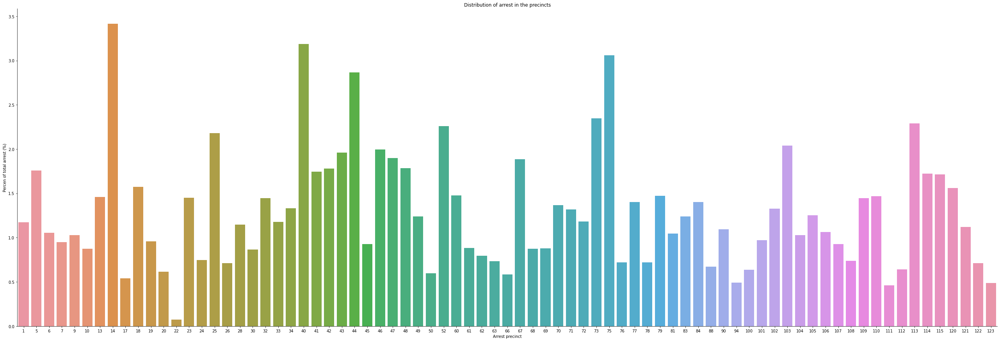

In [ ]:
# Finding how the much the arrest happens in each precients
arrest_df = arrest['ARREST_KEY'].groupby(arrest['ARREST_PRECINCT']).count().to_frame().reset_index()
arrest_df['Procent'] = arrest_df['ARREST_KEY']/arrest_df['ARREST_KEY'].sum()*100

# Plotting a barchart of the arrest distribution 
plt.figure(figsize = (45,15))
sns.barplot(x='ARREST_PRECINCT', y='Procent', data=arrest_df).set(xlabel = 'Arrest precinct', ylabel = 'Percen of total arrest (%)')
#ax.set(xlabel='Borough', ylabel='Count')
sns.despine( top=True, right=True)
#plt.xticks(rotation=20)
plt.title('Distribution of arrest in the precincts')


As most people does not know which precinct lies where in each borough when we plotted an interactive choropleth map where the percent of each precincts arrest compared to the total number of arrests. We chose to include a hover function so if the reader holds the mouse above an area, then the specific percent of arrest, precinct and borough is shown. As the colour bar only shows a specific number of colours. 

In [ ]:
# Loads the geojson data file containing the precincts placement 
gdf = gpd.read_file('nyc-police-precincts.geojson.txt')
# Rename columns in geofile to match dataframe 
gdf = gdf.rename(columns = {'precinct': 'ARREST_PRECINCT'}, inplace = False)

# Count the number of arrest in each prescient and save to a data frame 
precincts_map = arrest['ARREST_KEY'].groupby(arrest['ARREST_PRECINCT']).count().to_frame().reset_index()
precincts_map['ARREST_KEY'] = precincts_map['ARREST_KEY']/precincts_map['ARREST_KEY'].sum()*100
precincts_map['ARREST_KEY']=precincts_map['ARREST_KEY'].apply(lambda x:round(x,2))

a = arrest['BOROUGH'].groupby(arrest['ARREST_PRECINCT']).unique().to_frame().reset_index()

b = pd.Series([])
for i in range(np.shape(a)[0]):
    b[i] = a['BOROUGH'][i][0]

a.insert(2,'BOR',b)

precincts_map = pd.merge(precincts_map, a[['ARREST_PRECINCT', 'BOR']], on="ARREST_PRECINCT")

# Change the types so it can be used in the map 
precincts_map['ARREST_PRECINCT']=precincts_map['ARREST_PRECINCT'].astype('str')
precincts_map['ARREST_KEY']=precincts_map['ARREST_KEY'].astype(float)

# Save as new geojson file 
c = pd.concat([gdf, precincts_map], axis=1)
c.to_file("Counties.geojson", driver='GeoJSON')


In [ ]:
# Plots a chooropleth over number of arrest 

# Count the number of arrest in each prescient and save to a data frame 
precincts_map = arrest['ARREST_KEY'].groupby(arrest['ARREST_PRECINCT']).count().to_frame().reset_index()
precincts_map['ARREST_KEY'] = precincts_map['ARREST_KEY']/precincts_map['ARREST_KEY'].sum()*100

a = arrest['BOROUGH'].groupby(arrest['ARREST_PRECINCT']).unique().to_frame().reset_index()

b = pd.Series([])
for i in range(np.shape(a)[0]):
    b[i] = a['BOROUGH'][i][0]

a.insert(2,'BOR',b)

precincts_map = pd.merge(precincts_map, a[['ARREST_PRECINCT', 'BOR']], on="ARREST_PRECINCT")

# Change the types so it can be used in the map 
precincts_map['ARREST_PRECINCT']=precincts_map['ARREST_PRECINCT'].astype('str')
precincts_map['ARREST_KEY']=precincts_map['ARREST_KEY'].astype(float)

# Loading the geojson data for the precincts 
nyc_geo_police = 'Counties.geojson'

# The start point for map 
communities_map = folium.Map(location=[40.693943, -73.985880], zoom_start=10)

# The choropleth map for the borough outline 
choropleth = folium.Choropleth(geo_data='Boroughs (1).geojson', 
             key_on='feature.properties.borough', 
             fill_color='YlGn', fill_opacity=0, line_opacity=1, width = 3 ,color = 'black').add_to(communities_map)


# The choropleth map for the number of arrest for the precincts     
choropleth = folium.Choropleth(geo_data=nyc_geo_police,
             data=precincts_map, # my dataset
             columns=['ARREST_PRECINCT', 'ARREST_KEY'], 
             key_on='feature.properties.ARREST_PRECINCT', 
             fill_color='YlGn', fill_opacity=0.7, line_opacity=0.3,
             legend_name='Procent of total arrest (%)'
             ).add_to(communities_map)

choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(fields = ['shape_area', 'ARREST_PRECINCT', 'ARREST_KEY'],aliases = ['Boroughs: ','Precients: ', 'Percent of total arrest (%): '] ))
 
# Plots the map 
communities_map

In [ ]:
communities_map.save("map_NYC_arrest.html")

The choropleth map above shows most of the precincts Bronx has high percent of the arrest orders compared to other places.  Staten Islands has a relative low crime arrest numbers compared to the other boroughs. The other boroughs has a few precincts with high numbers of arrest, so no matter which borough that is chosen there are always places where more criminalities happens.  

### Distribution of arrest in each borough 
The bar chart makes it possible to compare the relationship between the different categories and the relative difference in the occurrence of the events. On this bar chart is it clear that crime occur almost with the same frequency in each borough except from in Richmond/Staten island where only around 5% of all arrest occurs. So in the following analysis we will see that Richmond/Staten island probably will be lower than the other borough. 

Text(0.5, 1.0, 'Distribution of the arrest in the boroughs')

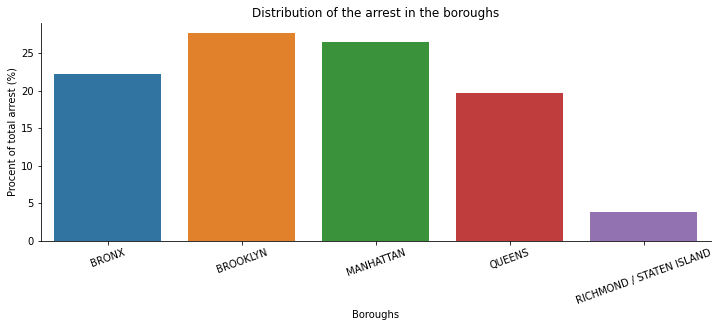

In [ ]:
# Counting how much the different difference arrest happens in each borough 
bour_df = arrest['ARREST_KEY'].groupby(arrest['BOROUGH']).count().to_frame().reset_index()
# Changing it to percent as easier comparison 
bour_df['Procent'] = bour_df['ARREST_KEY']/bour_df['ARREST_KEY'].sum()*100

# Plots the distribution 
plt.figure(figsize = (12,4))
sns.barplot(x='BOROUGH', y='Procent', data=bour_df).set(xlabel = 'Boroughs', ylabel = 'Procent of total arrest (%)')
sns.despine( top=True, right=True)
plt.xticks(rotation=20)
plt.title('Distribution of the arrest in the boroughs')


### Race in the arrestdata

The police apparently note the races of the offender, as one hears that there are areas in NYC that are divided on races, it could be interesting to see if it is reflected in the arrest data. First, we look at all the data plot a bar chart easily gives an overview of the distribution. Where almost 50% of the arrest are black and the second biggest part are white Hispanic. 

                        PERP_RACE  ARREST_KEY    Procent
0  AMERICAN INDIAN/ALASKAN NATIVE        3531   0.251864
1        ASIAN / PACIFIC ISLANDER       70973   5.062452
2                           BLACK      669785  47.775276
3                  BLACK HISPANIC      120177   8.572138
4                         UNKNOWN       12375   0.882700
5                           WHITE      169780  12.110284
6                  WHITE HISPANIC      355328  25.345287


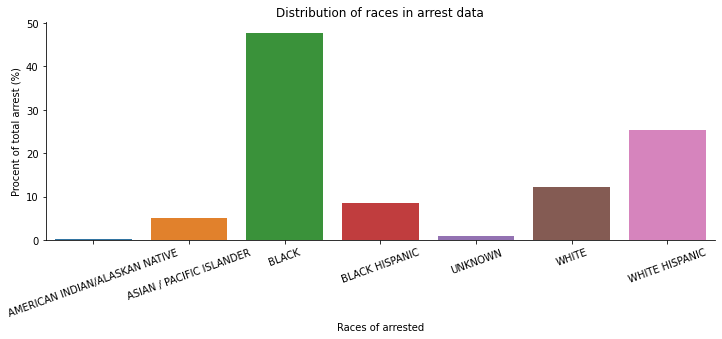

In [ ]:
# Counting how much the different races appear in the dataframe
race_dis = arrest['ARREST_KEY'].groupby(arrest['PERP_RACE']).count().to_frame().reset_index()
# Changing it to percent as easier comparison 
race_dis['Procent'] = race_dis['ARREST_KEY']/race_dis['ARREST_KEY'].sum()*100

# Plots the distribution 
plt.figure(figsize = (12,4))
sns.barplot(x='PERP_RACE', y='Procent', data=race_dis).set(xlabel = 'Races of arrested', ylabel = 'Procent of total arrest (%)')
sns.despine( top=True, right=True)
plt.xticks(rotation=20)
plt.title('Distribution of races in arrest data')

# Plot the dataframe to see the specific numbers for the webside 
print(race_dis)

#### The different races arrest in each borough 

It was possible to see a difference in the races in the arrests, next we plots for the neighbourhood to see if the distribution is the same or if there are difference. 

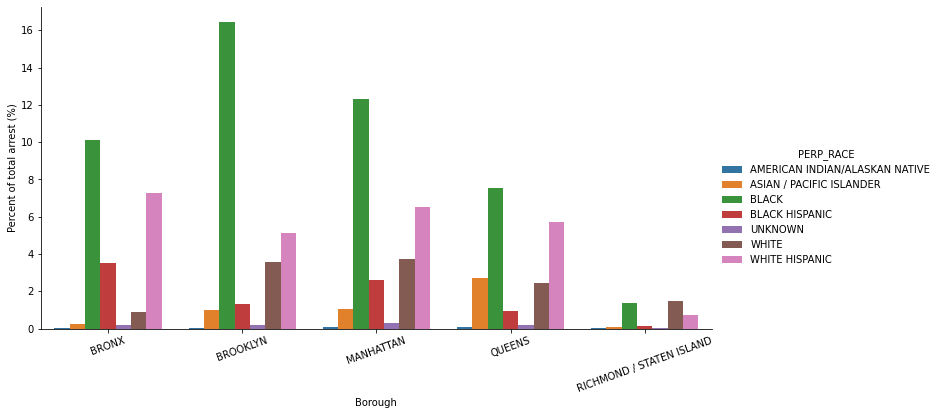

In [ ]:
#Count the different races in each borough
race_dis = arrest['ARREST_KEY'].groupby([arrest['BOROUGH'],arrest['PERP_RACE']]).count().to_frame().reset_index()
race_dis['Procent'] = race_dis['ARREST_KEY']/race_dis['ARREST_KEY'].sum()*100

ax = sns.catplot(x='BOROUGH', y='Procent', hue='PERP_RACE', kind='bar', 
            data=race_dis,height=5, # make the plot 5 units high
    aspect=2)
ax.set(xlabel='Borough', ylabel='Percent of total arrest (%)')
ax.set_xticklabels(rotation=20)


As a reference when looking at the features that happens in the boroughs, we first look just at the arrest numbers that happens in each borough. This can be seen in the figure below, where we can see that in Brooklyn has a very high percent of black than compared to the other races. In Queens there are a high percent of arrest that are Asian/pacific islander compared to the other boroughs. 

### Age distribution 
Another interesting feature could be the age groups to see if there are some places where people are younger or older when they commit a crime. This can be seen in the bar chart below where the age groups seems to have the same distribution in each borough also when one has in mind the distribution of arrest in each borough. 

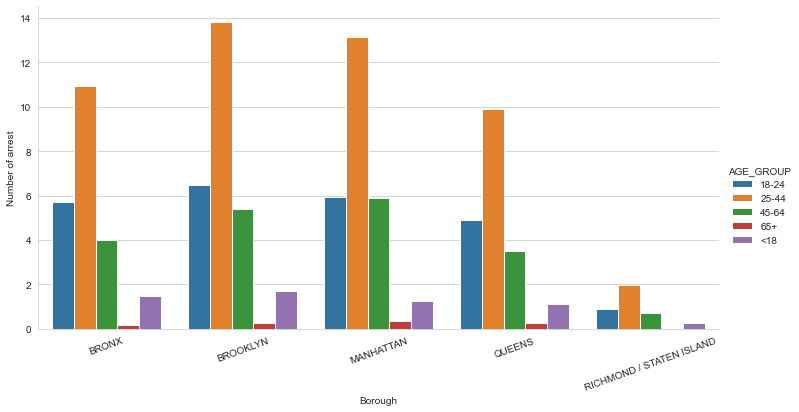

In [ ]:
# Count the agegroups in each borough
age_dis = arrest['ARREST_KEY'].groupby([arrest['BOROUGH'],arrest['AGE_GROUP']]).count().to_frame().reset_index()
age_dis['Procent'] = age_dis['ARREST_KEY']/age_dis['ARREST_KEY'].sum()*100

ax = sns.catplot(x='BOROUGH', y='Procent', hue='AGE_GROUP', kind='bar',
            data=age_dis,height=5, # make the plot 5 units high
    aspect=2)
ax.set(xlabel='Borough', ylabel='Percent of arrest (%)')
ax.set_xticklabels(rotation=20)


### Combining age and race 
We also looked if the races have the same age group distributions. Where there again is not a big difference in the pattern in each race compared to the distribution of the races and age groups separated. It can be seen that mostly that the people in the age 18-44 are arrested. 

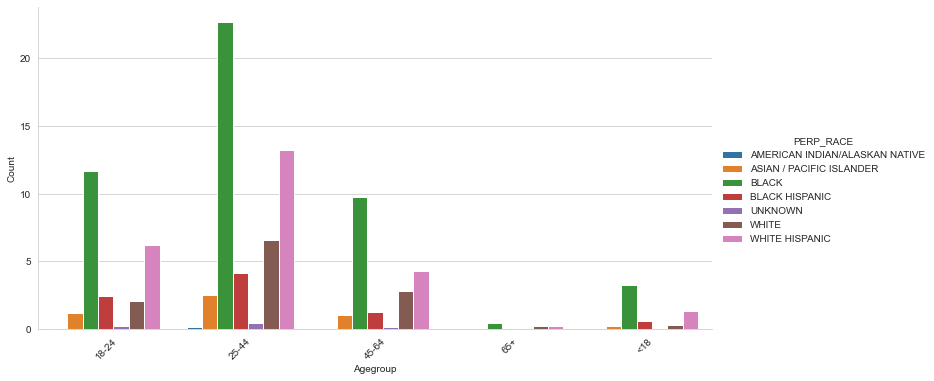

In [ ]:
# Count the different age group for each race
dis = arrest['ARREST_KEY'].groupby([arrest['AGE_GROUP'],arrest['PERP_RACE']]).count().to_frame().reset_index()
dis['Procent'] = dis['ARREST_KEY']/dis['ARREST_KEY'].sum()*100

ax = sns.catplot(x='AGE_GROUP', y='Procent', hue='PERP_RACE', kind='bar',
            data=dis,height=5, aspect=2)
ax.set(xlabel='Agegroup', ylabel='Count')
ax.set_xticklabels(rotation=45)


### Arrest offense

After different analysis of the crime types and reading the article [The impact of crime on property values: Research roundup](https://journalistsresource.org/economics/the-impact-of-crime-on-property-values-research-roundup/)
then we see that assault and robberies affect the house prices. First, we only look at the boroughs to see if there are a difference in the crime types. But as that there is not the big difference. But as seen earlier there can be a big change in both prices and arrest numbers in each borough. Then we look at each precinct instead, where we can see in the map below that the same areas that has cheap house prices also has a higher arrest rate. 


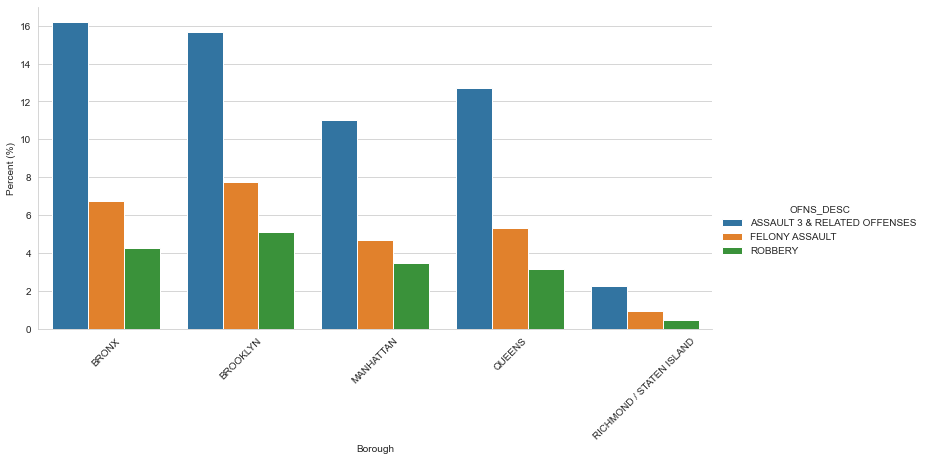

In [ ]:
cat = ['ASSAULT 3 & RELATED OFFENSES','FELONY ASSAULT','ROBBERY']
DA_out = arrest[arrest['OFNS_DESC'].isin(cat)]
# Count the agegroups in each borough
age_dis = DA_out['ARREST_KEY'].groupby([DA_out['BOROUGH'],DA_out['OFNS_DESC']]).count().to_frame().reset_index()
age_dis['Procent'] = age_dis['ARREST_KEY']/age_dis['ARREST_KEY'].sum()*100

ax = sns.catplot(x='BOROUGH', y='Procent', hue='OFNS_DESC', kind='bar',
            data=age_dis,height=5, aspect=2)
ax.set(xlabel='Borough', ylabel='Percent (%)')
ax.set_xticklabels(rotation=45)

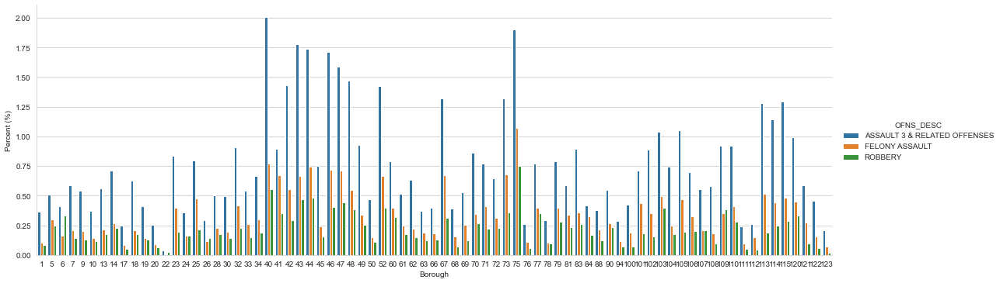

In [ ]:
# Count the agegroups in each borough
age_dis = DA_out['ARREST_KEY'].groupby([DA_out['ARREST_PRECINCT'],DA_out['OFNS_DESC']]).count().to_frame().reset_index()
age_dis['Procent'] = age_dis['ARREST_KEY']/age_dis['ARREST_KEY'].sum()*100

#plt.figure(figsize = (55,15))
ax = sns.catplot(x='ARREST_PRECINCT', y='Procent', hue='OFNS_DESC', kind='bar',
            data=age_dis,height=5, aspect=3)
ax.set(xlabel='Borough', ylabel='Percent (%)')



In [ ]:
#Filter crimes which related to house pricing
related_crime = arrest[(arrest.OFNS_DESC=='ASSAULT 3 & RELATED OFFENSES')
               |(arrest.OFNS_DESC=='FELONY ASSAULT')
               |(arrest.OFNS_DESC=='ROBBERY')]
related_crime_map = related_crime['ARREST_KEY'].groupby(arrest['ARREST_PRECINCT']).count().to_frame().reset_index()
related_crime_map['ARREST_KEY'] = related_crime_map['ARREST_KEY']/related_crime_map['ARREST_KEY'].sum()*100


related_crime_map['ARREST_PRECINCT']=related_crime_map['ARREST_PRECINCT'].astype('str')
related_crime_map['ARREST_KEY']=related_crime_map['ARREST_KEY'].astype(float)

In [ ]:
map = folium.Map(location=[40.693943, -73.985880], zoom_start=11)
map.choropleth(geo_data='nyc-police-precincts.geojson.txt',
             data=related_crime_map, # my dataset
             columns=['ARREST_PRECINCT', 'ARREST_KEY'], 
             key_on='feature.properties.precinct', 
             fill_color='YlGn', fill_opacity=0.7, line_opacity=0.3,
             legend_name='Crime Count')
map



### Precincts and races 
If one wants to see for a specific crime how it is placed specific in the boroughs, then we have plotted a marker cluster map. As there are many arrests then only 2019 is chosen to be shown.  

Each pin shows the placement of the arrest and the grouping of the arrest can be seen. One can up in the corner filter which crime types one wants to look closer to. If one clicks on the marker then the crime type and the race of the arrested appear. 

One has to be careful where there are one place with a lot of arrest, that is probably the police department. 


In [ ]:
df = DA_out
# Ensure you're handing it floats
df['Latitude'] = df['Latitude'].astype(float)
df['Longitude'] = df['Longitude'].astype(float)


# Filter the DF for rows, then columns, then remove NaNs
heat_df = df[df['Year']==2019] # Reducing data size so it runs faster
# heat_df = heat_df[heat_df['Month']==6]
heat_df['text'] = heat_df.apply(lambda row: 'Offense: ' + str(row['OFNS_DESC']) + ' and race: ' + row['PERP_RACE'], axis=1)

In [ ]:
map_hooray = folium.Map(location=[40.693943, -73.985880], zoom_start=10)
# The choropleth map for the borough outline 
folium.Choropleth(geo_data='Boroughs.geojson', 
             key_on='feature.properties.borough', 
             fill_color='YlGn', fill_opacity=0, line_opacity=1, width = 3 ,color = 'black', name = 'Borough outline').add_to(map_hooray)

callback = ('function (row) {' 
            'var marker = L.marker(new L.LatLng(row[0], row[1]), {color: "red"});'
            'var icon = L.AwesomeMarkers.icon({'
            "icon: 'map-marker',"
            "iconColor: 'white',"
            "markerColor: 'green',"
            "prefix: 'glyphicon',"
            "extraClasses: 'fa-rotate-0'"
                '});'
            'marker.setIcon(icon);'
            "var popup = L.popup({maxWidth: '300'});"
            "const display_text = {text: row[2]};"
            "var mytext = $(`<div id='mytext' class='display_text' style='width: 100.0%; height: 100.0%;'> ${display_text.text}</div>`)[0];"
            "popup.setContent(mytext);"
            "marker.bindPopup(popup);"
            'return marker};')
House_bo = heat_df[heat_df['OFNS_DESC'] == 'ROBBERY'].dropna(axis=0, subset=['Latitude','Longitude'])
plugins.FastMarkerCluster(House_bo[['Latitude', 'Longitude', 'text']],  callback=callback, name = 'Robbery - Green pin').add_to(map_hooray)

# 'ASSAULT 3 & RELATED OFFENSES','FELONY ASSAULT'
callback = ('function (row) {' 
            'var marker = L.marker(new L.LatLng(row[0], row[1]), {color: "red"});'
            'var icon = L.AwesomeMarkers.icon({'
            "icon: 'map-marker',"
            "iconColor: 'white',"
            "markerColor: 'blue',"
            "prefix: 'glyphicon',"
            "extraClasses: 'fa-rotate-0'"
                '});'
            'marker.setIcon(icon);'
            "var popup = L.popup({maxWidth: '300'});"
            "const display_text = {text: row[2]};"
            "var mytext = $(`<div id='mytext' class='display_text' style='width: 100.0%; height: 100.0%;'> ${display_text.text}</div>`)[0];"
            "popup.setContent(mytext);"
            "marker.bindPopup(popup);"
            'return marker};')
House_bo = heat_df[heat_df['OFNS_DESC'] == 'FELONY ASSAULT'].dropna(axis=0, subset=['Latitude','Longitude'])
plugins.FastMarkerCluster(House_bo[['Latitude', 'Longitude', 'text']],  callback=callback, name = 'Felony assult - blue pin').add_to(map_hooray)

callback = ('function (row) {' 
            'var marker = L.marker(new L.LatLng(row[0], row[1]), {color: "red"});'
            'var icon = L.AwesomeMarkers.icon({'
            "icon: 'map-marker',"
            "iconColor: 'white',"
            "markerColor: 'red',"
            "prefix: 'glyphicon',"
            "extraClasses: 'fa-rotate-0'"
                '});'
            'marker.setIcon(icon);'
            "var popup = L.popup({maxWidth: '300'});"
            "const display_text = {text: row[2]};"
            "var mytext = $(`<div id='mytext' class='display_text' style='width: 100.0%; height: 100.0%;'> ${display_text.text}</div>`)[0];"
            "popup.setContent(mytext);"
            "marker.bindPopup(popup);"
            'return marker};')
House_bo = heat_df[heat_df['OFNS_DESC'] == 'ASSAULT 3 & RELATED OFFENSES'].dropna(axis=0, subset=['Latitude','Longitude'])
plugins.FastMarkerCluster(House_bo[['Latitude', 'Longitude', 'text']],  callback=callback, name = 'Assult and related offense - red pin').add_to(map_hooray)


folium.LayerControl().add_to(map_hooray)

map_hooray

### Arrest count in each year and borough

In [ ]:
reset_output()
output_notebook()

year_bor=pd.crosstab(arrest['BOROUGH'], arrest['Year'], values=arrest['Year'], aggfunc='count').T
year_bro_bk = ColumnDataSource(data=year_bor)
h=[i for i in range(2016,2020)]
list_of_borough = arrest['BOROUGH'].unique()

# get vector of colors to plot the bars
colors = Category10[len(list_of_borough)]

# Create the figure 
p = figure(plot_height=400, plot_width=600,title="Crime in each year",
toolbar_location=None, tools="", x_axis_label="Year",
           y_axis_label="Crime count")


# Defining variable for the vbars
bar ={} 

# Defining variable for the legend
legend_it = []

# For loop that runs that for each focus crimes create a bar plot with separate colors 
for indx,i in enumerate(list_of_borough):
    bar[i] = p.vbar(x='Year', top=i, source=year_bro_bk, color=colors[indx],muted_alpha=0.2,muted=True) 
    legend_it.append((i, [bar[i]]))

# Creating the legends for the crimes
legend = Legend(items=legend_it)
# Defining the way the legends should be represented when cliking on the legend
legend.click_policy="mute"

# Adds the legend and placement of the legend in the plot 
p.add_layout(legend, 'right')

# Displaying the plot 
show(p)     

Loading BokehJS ...

From 2016 to 2019, the total amount of crimes is declining, and for each year ,Brooklyn has the highest number of crimes, Richmond the lowest.

### Different crime count changes over the years/months

There are too many crime categories to plot clearly, so we filter the type of crime and select those with a high number of records that have value for analysis.

<AxesSubplot:>

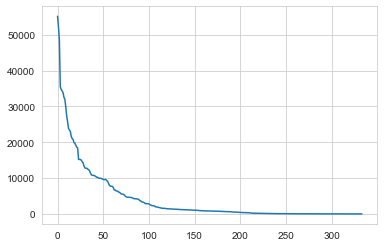

In [ ]:
#check the total number of different kinds of crimes
d1 = arrest['ARREST_KEY'].groupby([arrest["Year"],arrest['OFNS_DESC']]).count().to_frame().reset_index().sort_values('ARREST_KEY',ascending=False)
d1 = d1.reset_index()
d1['ARREST_KEY'].plot()

In [ ]:
#Top 50 rows with over 5,000 crime occurrences, choose those columns
sub_d1 = d1.iloc[:50].reset_index()
crime_list = sub_d1['OFNS_DESC'].unique()
crime_list.size

14

In [ ]:
#filter the dataset depends on upon crime list
d = pd.DataFrame([])
for i in crime_list:
  l = arrest.loc[arrest['OFNS_DESC']==i]
  d = d.append(l)
 
d.head()

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,...,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Year,Month,Day,BOROUGH
23,189907410,11/12/2018,568.0,"MARIJUANA, POSSESSION 1, 2 & 3",117.0,DANGEROUS DRUGS,PL 2213000,F,Q,108,...,WHITE,996644.0,209958.0,40.742962,-73.955274,POINT (-73.95527424799997 40.74296235400004),2018,11,12,QUEENS
32,189457670,11/01/2018,569.0,"MARIJUANA, SALE 4 & 5",235.0,DANGEROUS DRUGS,PL 2214000,M,S,121,...,BLACK,939646.0,171536.0,40.637399,-74.160713,POINT (-74.16071284299994 40.63739917600003),2018,11,1,RICHMOND / STATEN ISLAND
97,188347566,10/04/2018,511.0,"CONTROLLED SUBSTANCE, POSSESSION 7",235.0,DANGEROUS DRUGS,PL 2200300,M,B,44,...,BLACK,1010425.0,246597.0,40.843496,-73.905399,POINT (-73.90539890999997 40.84349641100005),2018,10,4,BRONX
142,187143579,09/02/2018,567.0,"MARIJUANA, POSSESSION 4 & 5",235.0,DANGEROUS DRUGS,PL 2211002,M,K,67,...,BLACK,998588.0,172194.0,40.639306,-73.948339,POINT (-73.94833915399995 40.639305956000044),2018,9,2,BROOKLYN
164,185234108,07/16/2018,515.0,"CONTROLLED SUBSTANCE,SALE 3",117.0,DANGEROUS DRUGS,PL 2203901,F,M,7,...,BLACK,987009.0,199047.0,40.713023,-73.990049,POINT (-73.99004929899996 40.713022567000046),2018,7,16,MANHATTAN


Take a look at the distribution of filtered-crimes in each year.

In [ ]:
## Data processing to get correct data into bins:

#NoOutlier = sub['Hour']
list_of_category = d['OFNS_DESC'].unique()
HistData={}
for indx,i in enumerate(list_of_category):
    bins = 8 
    dataframe=d[d['OFNS_DESC']==i]
    column = 'Year'

    hist, edges = np.histogram(dataframe[column], bins = bins)
    hist_df = pd.DataFrame({column: hist,
                        "left": edges[:-1],
                        "right": edges[1:]})
    hist_df["interval"] = ["%d to %d" % (left, right) for left, 
                           right in zip(hist_df["left"], hist_df["right"])]
    
    
    HistData[i]=ColumnDataSource(hist_df)
    
    
# create plot 
reset_output()
output_notebook()

# initialize standard settings for the plot: 
plot = figure(plot_height = 550, plot_width = 900, title = 'Crime count in each year', x_axis_label = 'Year',y_axis_label = "Count",)  

# Create empty dictionary for bars
bar={}
# create empty legend list
legend_it = []

# define colors for the boroughs
colors = Category20[len(list_of_category)]

for indx,i in enumerate(list_of_category):
    src = HistData[i]
    
    bar[i]=plot.quad(top=column, bottom=0, left = "left", right = "right",source=src, color=colors[indx], muted_alpha=0.2,muted=True) 
    
    
    legend_it.append((i, [bar[i]]))

legend = Legend(items=legend_it)
legend.click_policy="mute"
plot.add_layout(legend, 'right')

#displays plot:
show(plot) 

Loading BokehJS ...

Take a look at the distribution of filtered-crimes in each month.

In [ ]:
## Data processing to get correct data into bins:

#NoOutlier = sub['Hour']
list_of_category = d['OFNS_DESC'].unique()
HistData={}
for indx,i in enumerate(list_of_category):
    bins = 30 
    dataframe=d[d['OFNS_DESC']==i]
    column = 'Month'

    hist, edges = np.histogram(dataframe[column], bins = bins)
    hist_df = pd.DataFrame({column: hist,
                        "left": edges[:-1],
                        "right": edges[1:]})
    hist_df["interval"] = ["%d to %d" % (left, right) for left, 
                           right in zip(hist_df["left"], hist_df["right"])]
    
    
    HistData[i]=ColumnDataSource(hist_df)
    
    
# create plot 
reset_output()
output_notebook()

# initialize standard settings for the plot: 
plot = figure(plot_height = 550, plot_width = 900, title = 'Crime count in each month', x_axis_label = 'Month',y_axis_label = "Count",)  

# Create empty dictionary for bars
bar={}
# create empty legend list
legend_it = []

# define colors for the boroughs
colors = Category20[len(list_of_category)]

for indx,i in enumerate(list_of_category):
    src = HistData[i]
    
    bar[i]=plot.quad(top=column, bottom=0, left = "left", right = "right",source=src, color=colors[indx], muted_alpha=0.2,muted=True) 
    
    
    legend_it.append((i, [bar[i]]))

legend = Legend(items=legend_it)
legend.click_policy="mute"
plot.add_layout(legend, 'right')

#displays plot:
show(plot) 

Loading BokehJS ...

## Loading two data sets

In [ ]:
Crimedata = pd.read_csv("NYPD_Arrests_Data__Historic_Last_5_years.csv")
Housedata = pd.read_csv('HousedataProcessed.csv')

In [ ]:
# in order to map the characters into different names of the boroughs
dict_a = { 'M':"MANHATTAN",
     'K':"BROOKLYN",
     'Q':"QUEENS",
     'B':"BRONX",
     'S':"RICHMOND / STATEN ISLAND"}
Crimedata['BOROUGH']=Crimedata['ARREST_BORO'].map(dict_a)

#### Due to the large number of data  will be selected for limited time period and some interesting variables and types of crime

In [ ]:
Crimedata['ARREST_DATE']=pd.to_datetime(Crimedata['ARREST_DATE'],infer_datetime_format=True)

In [ ]:
Crimedata = Crimedata[(pd.DatetimeIndex(Crimedata['ARREST_DATE']).year == 2019)]
Housedata = Housedata[(pd.DatetimeIndex(Housedata['SALE DATE']).year == 2019)]

#### Selecting crime types
Only 3 types of crimes is chosen due to the limited computational power. These 3 types are found to be more relevant for house prices.

In [ ]:
# Selecting interesting variables to look at when considering house location
list_interest_house = ['Latitude','Longitude','SALE PRICE','BOROUGH','ZIP CODE','LAND SQUARE FEET','GROSS SQUARE FEET']
# crime variables
list_interest_crime = ['Latitude','Longitude','PERP_RACE','BOROUGH','OFNS_DESC']
# type of OFNS_DESC
list_interest_crime_type = ['ASSAULT 3 & RELATED OFFENSES','ROBBERY','FELONY ASSAULT']

In [ ]:
# reduce crime data to only contain interesting crime types: 
reduceCrime = Crimedata[Crimedata['OFNS_DESC'].isin(list_interest_crime_type)]

In [ ]:
subCrimedata = reduceCrime[list_interest_crime]
subHousedata = Housedata[list_interest_house]

In [ ]:
print(f'The size of crime data after selecting interesting variables and dates is {subCrimedata.shape[0]}' )
print(f'The size house sale data after selecting interesting variables and dates is {subHousedata.shape[0]}' )
print('The numbers is yet too large, therefore random sampling will be applied')

The size of crime data after selecting interesting variables and dates is 56455
The size house sale data after selecting interesting variables and dates is 23211
The numbers is yet too large, therefore random sampling will be applied


In [ ]:
reducedHouse = subHousedata.sample(frac=0.5, replace=True, random_state=1)

reducedCrime = subCrimedata.sample(frac=0.5, replace=True, random_state=1)

print(f'The size of crime data after random sampling {reducedCrime.shape[0]}')
print(f'The size house sale data after random sampling {reducedHouse.shape[0]}')

The size of crime data after random sampling 28228
The size house sale data after random sampling 11606


In [ ]:
reducedCrime['Latitude'] = reducedCrime['Latitude'].round(decimals=2)
reducedCrime['Longitude'] = reducedCrime['Longitude'].round(decimals=2)
reducedHouse['Latitude'] = reducedHouse['Latitude'].round(decimals=2)
reducedHouse['Longitude'] = reducedHouse['Longitude'].round(decimals=2)

In [ ]:
#reducedHouse=reducedHouse.set_index('lat_long')
#reducedCrime=reducedCrime.set_index('lat_long')

merged_df = pd.merge(reducedHouse, reducedCrime, how='inner', on=['Latitude','Longitude'])


# making sure there are no missing values
merged_df.dropna(inplace=True)
print(f'The size of merged dataframe is {merged_df.shape[0]}')
merged_df.head()

The size of merged dataframe is 374517


,Latitude,Longitude,SALE PRICE,BOROUGH_x,ZIP CODE,LAND SQUARE FEET,GROSS SQUARE FEET,PERP_RACE,BOROUGH_y,OFNS_DESC
0,40.89,-73.82,468000,BRONX,10475.0,2742.0,1925.0,BLACK,BRONX,FELONY ASSAULT
1,40.89,-73.82,468000,BRONX,10475.0,2742.0,1925.0,BLACK,BRONX,FELONY ASSAULT
2,40.89,-73.82,540000,BRONX,10475.0,2500.0,2160.0,BLACK,BRONX,FELONY ASSAULT
3,40.89,-73.82,540000,BRONX,10475.0,2500.0,2160.0,BLACK,BRONX,FELONY ASSAULT
4,40.89,-73.82,468000,BRONX,10475.0,2742.0,1925.0,BLACK,BRONX,FELONY ASSAULT


In [ ]:
merged_df['BOROUGH']=merged_df['BOROUGH_x']
merged_df.drop(['BOROUGH_x','BOROUGH_y'], axis='columns', inplace=True)
target=merged_df.BOROUGH

# Machine Learning 

In [ ]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import LabelBinarizer
from sklearn.decomposition import PCA

#### Data processing of the meged data

The data needs to be encoded as the borough, race and ofns_desc are strings / categories
But this following experiment is use borough as the unknown target for PCA

## PCA

The aim of using PCA here is to gain insight, this is used as an exploratory tool 

In [ ]:
# Encode the data:
y_b = pd.get_dummies(merged_df.BOROUGH)
y_r = pd.get_dummies(merged_df.PERP_RACE)
y_o = pd.get_dummies(merged_df.OFNS_DESC)

In [ ]:
# insert the columns into the merged_df
for col in y_b.columns:
    merged_df[col]=y_b[col]

for col in y_r.columns:
    merged_df[col]=y_r[col]   
    
for col in y_o.columns:
    merged_df[col]=y_o[col]      

In [ ]:
merged_df.drop(['BOROUGH', 'PERP_RACE','OFNS_DESC'], axis='columns', inplace=True)

In [ ]:
merged_df.columns

Index(['Latitude', 'Longitude', 'SALE PRICE', 'ZIP CODE', 'LAND SQUARE FEET',
       'GROSS SQUARE FEET', 'BRONX', 'BROOKLYN', 'MANHATTAN', 'QUEENS',
       'RICHMOND / STATEN ISLAND', 'AMERICAN INDIAN/ALASKAN NATIVE',
       'ASIAN / PACIFIC ISLANDER', 'BLACK', 'BLACK HISPANIC', 'UNKNOWN',
       'WHITE', 'WHITE HISPANIC', 'ASSAULT 3 & RELATED OFFENSES',
       'FELONY ASSAULT', 'ROBBERY'],
      dtype='object')

In [ ]:
merged_df

,Latitude,Longitude,SALE PRICE,ZIP CODE,LAND SQUARE FEET,GROSS SQUARE FEET,BRONX,BROOKLYN,MANHATTAN,QUEENS,...,AMERICAN INDIAN/ALASKAN NATIVE,ASIAN / PACIFIC ISLANDER,BLACK,BLACK HISPANIC,UNKNOWN,WHITE,WHITE HISPANIC,ASSAULT 3 & RELATED OFFENSES,FELONY ASSAULT,ROBBERY
0,40.89,-73.82,468000,10475.0,2742.0,1925.0,1,0,0,0,...,0,0,1,0,0,0,0,0,1,0
1,40.89,-73.82,468000,10475.0,2742.0,1925.0,1,0,0,0,...,0,0,1,0,0,0,0,0,1,0
2,40.89,-73.82,540000,10475.0,2500.0,2160.0,1,0,0,0,...,0,0,1,0,0,0,0,0,1,0
3,40.89,-73.82,540000,10475.0,2500.0,2160.0,1,0,0,0,...,0,0,1,0,0,0,0,0,1,0
4,40.89,-73.82,468000,10475.0,2742.0,1925.0,1,0,0,0,...,0,0,1,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
374512,40.76,-73.94,735000,11106.0,2523.0,1380.0,0,0,0,1,...,0,0,0,0,0,1,0,1,0,0
374513,40.76,-73.94,735000,11106.0,2523.0,1380.0,0,0,0,1,...,0,0,1,0,0,0,0,1,0,0
374514,40.76,-73.94,735000,11106.0,2523.0,1380.0,0,0,0,1,...,0,0,1,0,0,0,0,0,1,0
374515,40.76,-73.94,735000,11106.0,2523.0,1380.0,0,0,0,1,...,0,0,1,0,0,0,0,0,1,0


In [ ]:
# standardise the data
x = StandardScaler().fit_transform(merged_df)

# generate PCA loadings
pca = PCA(n_components=4)
principalComponents = pca.fit_transform(x)

# Look at the variance explained

principalDf = pd.DataFrame(data = principalComponents
             , columns = ['PC1', 'PC2','PC3','PC4'])
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))


Explained variation per principal component: [0.14879367 0.12829116 0.09476907 0.08109601]


The variance explained for each principal component are not large enough to only use 2 components to divide the data. But for the sake of visualization, only 2 chosen. 

##### See the principal component weights:

In [ ]:
finalDf = pd.concat([principalDf, target.to_frame()], axis = 1)
prinpP = pd.DataFrame(data=pca.components_, columns = merged_df.columns)
prinpP.head()

,Latitude,Longitude,SALE PRICE,ZIP CODE,LAND SQUARE FEET,GROSS SQUARE FEET,BRONX,BROOKLYN,MANHATTAN,QUEENS,...,AMERICAN INDIAN/ALASKAN NATIVE,ASIAN / PACIFIC ISLANDER,BLACK,BLACK HISPANIC,UNKNOWN,WHITE,WHITE HISPANIC,ASSAULT 3 & RELATED OFFENSES,FELONY ASSAULT,ROBBERY
0,0.499746,0.009758,-0.139949,-0.504967,-0.014637,0.054781,0.531879,-0.293968,0.093271,-0.226317,...,0.000610,-0.120669,-0.006177,0.124843,-0.005793,-0.084714,0.064444,0.026414,-0.021090,-0.010109
1,-0.162134,-0.520148,0.239632,-0.214293,-0.075341,0.248916,-0.045916,0.381115,0.119556,-0.485629,...,-0.018775,-0.193685,0.107123,0.012420,-0.006344,0.101978,-0.068800,-0.082092,0.018259,0.089308
2,-0.134153,-0.269961,-0.069327,-0.121373,0.243253,-0.118066,-0.068702,-0.209374,-0.044182,0.090320,...,0.025666,0.109046,-0.444784,0.038123,0.006825,0.287844,0.246101,0.314159,-0.139335,-0.256742
3,-0.027312,-0.061552,-0.089674,-0.052784,0.114032,-0.105473,-0.006612,-0.140509,-0.038804,0.075572,...,-0.043469,0.052630,-0.159661,0.023374,0.032273,0.101223,0.077443,-0.661568,0.624268,0.135625


##### Plot the observations according to two principal components

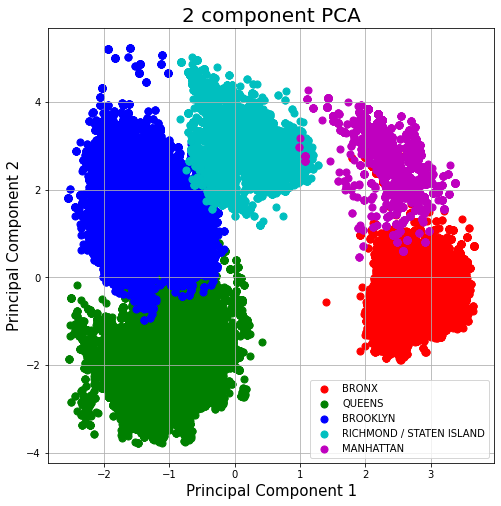

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)

targets = reducedHouse['BOROUGH'].unique()
colors = ['r', 'g', 'b','c','m']

for target_, color in zip(targets,colors):
    indicesToKeep = finalDf['BOROUGH'] == target_
    ax.scatter(finalDf.loc[indicesToKeep, 'PC1']
               , finalDf.loc[indicesToKeep, 'PC2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

### PCA plot 
We can clearly see that the PCA plot shows that by including the names of the boroughs in the dataset, the clusters is affected by locational information, We see that the weights for BRONX and Latitude contriutes positively in PC1 
While Longitude	and QUEENS weights negatively on PC2. The placement of the clusters are less affected by the crime attributes (see the values of the principal components in the table)

## Second experiment with PCA
As we see, the zip code, longitude, latitude and some of the Borough names are the most dominant values in the first PCA experiment. Following experiment will exclude boroughs to investigate if we can eleminate the effect. 

In [ ]:
df_PCA = merged_df
df_PCA.drop(['BRONX','BROOKLYN','MANHATTAN','QUEENS','RICHMOND / STATEN ISLAND'], axis='columns', inplace=True)
df_PCA.head()

,Latitude,Longitude,SALE PRICE,ZIP CODE,LAND SQUARE FEET,GROSS SQUARE FEET,AMERICAN INDIAN/ALASKAN NATIVE,ASIAN / PACIFIC ISLANDER,BLACK,BLACK HISPANIC,UNKNOWN,WHITE,WHITE HISPANIC,ASSAULT 3 & RELATED OFFENSES,FELONY ASSAULT,ROBBERY
0,40.89,-73.82,468000,10475.0,2742.0,1925.0,0,0,1,0,0,0,0,0,1,0
1,40.89,-73.82,468000,10475.0,2742.0,1925.0,0,0,1,0,0,0,0,0,1,0
2,40.89,-73.82,540000,10475.0,2500.0,2160.0,0,0,1,0,0,0,0,0,1,0
3,40.89,-73.82,540000,10475.0,2500.0,2160.0,0,0,1,0,0,0,0,0,1,0
4,40.89,-73.82,468000,10475.0,2742.0,1925.0,0,0,1,0,0,0,0,0,1,0


In [ ]:
x = StandardScaler().fit_transform(df_PCA)
pca_2 = PCA(n_components=2)
principalComponents_2 = pca_2.fit_transform(x)

principalDf_2 = pd.DataFrame(data = principalComponents_2
             , columns = ['PC1', 'PC2'])

In [ ]:
print('Explained variation per principal component: {}'.format(pca_2.explained_variance_ratio_))

Explained variation per principal component: [0.11590121 0.11312508]


In [ ]:
finalDf_ = pd.concat([principalDf_2, target.to_frame()], axis = 1)

In [ ]:
prinpP = pd.DataFrame(data=pca_2.components_, columns = df_PCA.columns)
prinpP

,Latitude,Longitude,SALE PRICE,ZIP CODE,LAND SQUARE FEET,GROSS SQUARE FEET,AMERICAN INDIAN/ALASKAN NATIVE,ASIAN / PACIFIC ISLANDER,BLACK,BLACK HISPANIC,UNKNOWN,WHITE,WHITE HISPANIC,ASSAULT 3 & RELATED OFFENSES,FELONY ASSAULT,ROBBERY
0,0.552636,-0.101840,-0.062869,-0.590875,-0.042294,0.156803,0.015892,-0.200979,-0.179820,0.234750,-0.013370,-0.082557,0.253155,0.240189,-0.20561,-0.074993
1,0.155953,-0.148231,0.126886,-0.242400,-0.087433,0.228020,-0.058002,-0.232004,0.270901,0.042186,0.000263,-0.093901,-0.128009,-0.616552,0.41513,0.330425


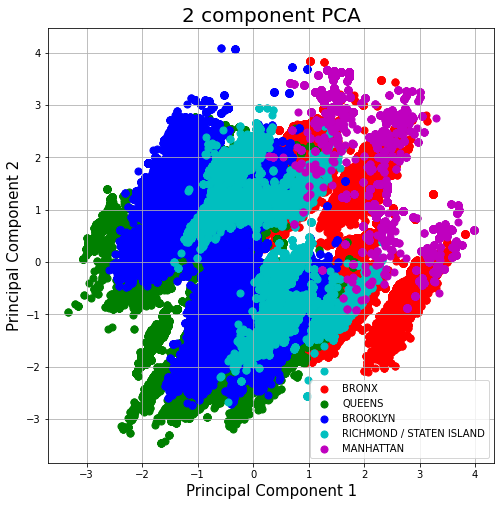

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)

targets = reducedHouse['BOROUGH'].unique()
colors = ['r', 'g', 'b','c','m']

for target_, color in zip(targets,colors):
    indicesToKeep = finalDf_['BOROUGH'] == target_
    ax.scatter(finalDf_.loc[indicesToKeep, 'PC1']
               , finalDf_.loc[indicesToKeep, 'PC2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

### PCA  without including locational variables
We can see on this plot, that if we exclude the variables Boroughs, the data will become more less separated than before. 

### See the correlation of the variables
We are interested in finding the correaltion for each variables. 
We are mostly interested in those variables that are highly correlated with some boroughs, besides zip code which is directly related. 

In [ ]:
# insert the boroughs back to the data
for col in y_b.columns:
    merged_df[col]=y_b[col]

merged_df.head()

,Latitude,Longitude,SALE PRICE,ZIP CODE,LAND SQUARE FEET,GROSS SQUARE FEET,AMERICAN INDIAN/ALASKAN NATIVE,ASIAN / PACIFIC ISLANDER,BLACK,BLACK HISPANIC,...,WHITE,WHITE HISPANIC,ASSAULT 3 & RELATED OFFENSES,FELONY ASSAULT,ROBBERY,BRONX,BROOKLYN,MANHATTAN,QUEENS,RICHMOND / STATEN ISLAND
0,40.89,-73.82,468000,10475.0,2742.0,1925.0,0,0,1,0,...,0,0,0,1,0,1,0,0,0,0
1,40.89,-73.82,468000,10475.0,2742.0,1925.0,0,0,1,0,...,0,0,0,1,0,1,0,0,0,0
2,40.89,-73.82,540000,10475.0,2500.0,2160.0,0,0,1,0,...,0,0,0,1,0,1,0,0,0,0
3,40.89,-73.82,540000,10475.0,2500.0,2160.0,0,0,1,0,...,0,0,0,1,0,1,0,0,0,0
4,40.89,-73.82,468000,10475.0,2742.0,1925.0,0,0,1,0,...,0,0,0,1,0,1,0,0,0,0


In [ ]:
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(merged_df)
df_stand = pd.DataFrame(x_scaled, columns=merged_df.columns)

<AxesSubplot:>

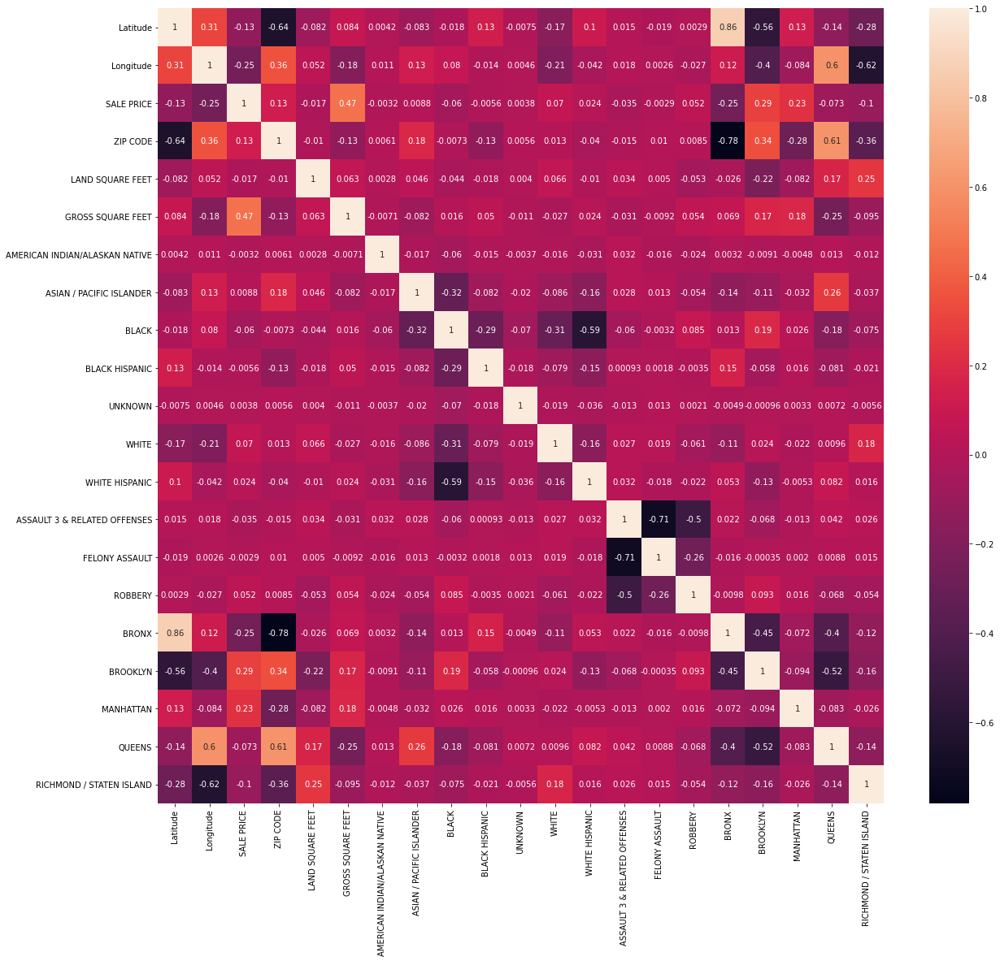

In [ ]:
plt.figure(figsize=(20,18))
sns.heatmap(df_stand.corr(), annot=True)

### Observations 

It is expected that zipcode is highly correlated with all the boroughs. And Boroughs are inter-dependent with each other as if one observation belongs to one borough, it cannot be in an other. Which is expected. 

- asian/pacific islander is positive correlated with Queens
- Bronx has a positive correlation with black hispanic 
- SALE PRICE is mostly positve correlated to gross square feet and Manhattan and Brooklyn

From these slighly small correlations it is not possible to draw conclusions.

Based analysis of the correlation between different parameters, the sale price is mostly affected by the size, Manhattan and Brooklyn while the crimes are not as influential. None of the crime types mentioned are significantly affecting the decision.


## Agglomerative clustering  / Hierarchy  clustering
Unsupervised learning is usually a great tool to explore patterns within our dataset which we are very interested in. Hereby we will use a clusering model that can group the data such that we can see which variable is dragging the observations into clusters. 
The method  Hierarchy clustering is a bottom up strategy, where for each layer the algorithm reduces the number of clusters. Observations that are close to each other will be within same cluster. 

In [ ]:
merged_df.head()

,Latitude,Longitude,SALE PRICE,ZIP CODE,LAND SQUARE FEET,GROSS SQUARE FEET,AMERICAN INDIAN/ALASKAN NATIVE,ASIAN / PACIFIC ISLANDER,BLACK,BLACK HISPANIC,...,WHITE,WHITE HISPANIC,ASSAULT 3 & RELATED OFFENSES,FELONY ASSAULT,ROBBERY,BRONX,BROOKLYN,MANHATTAN,QUEENS,RICHMOND / STATEN ISLAND
0,40.89,-73.82,468000,10475.0,2742.0,1925.0,0,0,1,0,...,0,0,0,1,0,1,0,0,0,0
1,40.89,-73.82,468000,10475.0,2742.0,1925.0,0,0,1,0,...,0,0,0,1,0,1,0,0,0,0
2,40.89,-73.82,540000,10475.0,2500.0,2160.0,0,0,1,0,...,0,0,0,1,0,1,0,0,0,0
3,40.89,-73.82,540000,10475.0,2500.0,2160.0,0,0,1,0,...,0,0,0,1,0,1,0,0,0,0
4,40.89,-73.82,468000,10475.0,2742.0,1925.0,0,0,1,0,...,0,0,0,1,0,1,0,0,0,0


For testing the performance of optimal number of clusters needed the model is being called multiple times with several different clusters

In [ ]:
def hyper_param_optimal_k(X): 
    score = []
    K = np.arange(2, 22, 2)
    for k in K:
        AC = AgglomerativeClustering(n_clusters=k)
        y_hat = AC.fit_predict(X)
        silhouette_s = silhouette_score(X, y_hat)
        score.append(silhouette_s)
    plt.plot(K, score, '-o', label="Silhouette score")
    plt.xlabel('k')
    plt.title("Clustering score")
    plt.legend()
    plt.grid()
    plt.show()   

In [ ]:
X = merged_df.sample(frac=0.01, replace=True, random_state=1)
print(f'The data used for this is reduced to {X.shape[0]}')
print(f'the reason for reducing the number of observations is due to the computational power is limited')

The data used for this is reduced to 3745
the reason for reducing the number of observations is due to the computational power is limited


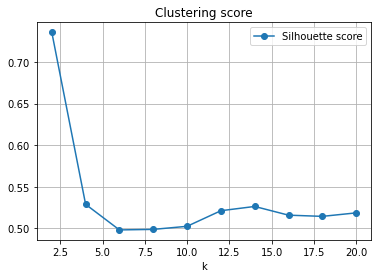

In [ ]:
hyper_param_optimal_k(X)

As shown in this graph, the optimal k is around k = 4 where silhouette score is dropping to 0.49
In machine learning the most simple model is often preferred

In [ ]:
# building the optimal clustering: 
AC = AgglomerativeClustering(n_clusters=6)
y_hat_H = AC.fit_predict(X)
silhouette_score(X, y_hat_H)
#X['y_hat']=y_hat

0.4979121952539125

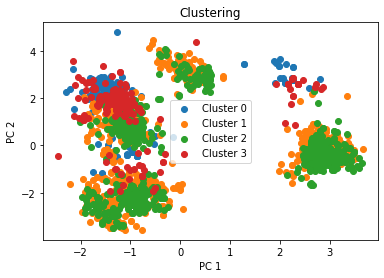

In [ ]:
# generate observations as PCA
x = StandardScaler().fit_transform(X)
X_pca = PCA(n_components=4).fit_transform(x)

# plot observations according to the clusters
k=4
for i in range(k):
    plt.scatter(X_pca[y_hat_H == i, 0], X_pca[y_hat_H == i, 1], label=f'Cluster {i}')
plt.legend()
plt.xlabel('PC 1')
plt.ylabel('PC 2')
plt.title("Clustering")
plt.show()

### Conclusion on Hierachical clustering: 
The optimal number of cluster based on sihuette score is k = 6 ( silhouette score is 0.49 ) where we are unable to see clear separation due to we are only plotting in 2D. We can see in PCA plot that we have data grouped into two main cluster in 2D. We will need more component from PCA in order to explain the data more accurately.


## K-Means

Another model that is usefull for unsupervised learning is K-means. K-means finds start out by assigning observations that are close to each other to fixed number of clusters. This procedure is repeted until convergence. The distance measure used is spherical. K-means is less computational heavy compared to hierachical clustering. That is why it is worth trying out if the performance is better. 


In [ ]:
def hyper_param_optimal_kmeans(X, K): 
    score = []
    elbow = []
    for k in K:
        KM = KMeans(n_clusters=k)
        KM.fit(X)
        y_hat = KM.predict(X)
        silhouette_s = silhouette_score(X, y_hat)
        score.append(silhouette_s)
        elbow.append(KM.inertia_)
    
    fig, axs = plt.subplots(1,2,figsize=(15,5))
   
    axs[0].plot(K, elbow, '-o', label="elbow method")
    axs[0].title.set_text("Clustering score K-means")
    axs[0].set(xlabel='k', ylabel='WCSS')
   
    axs[1].plot(K, score, '-o', label="Silhouette score")
    axs[1].title.set_text("Silhouette score K-means")
    axs[1].set(xlabel='k', ylabel='Silhouette score')
  

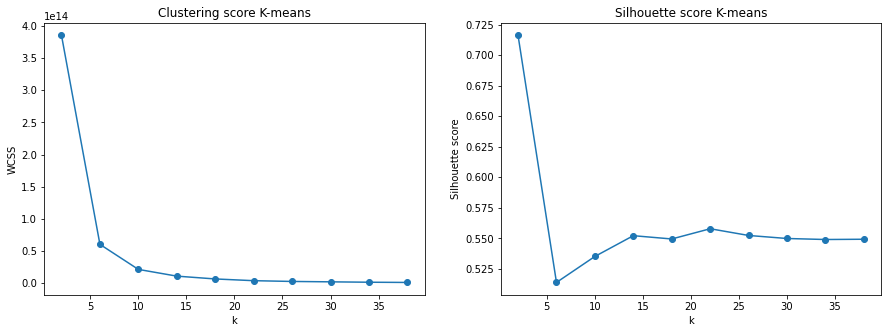

In [ ]:
K = np.arange(2, 40, 4)
hyper_param_optimal_kmeans(X,K)

### Finding the correct hyper parameter for k-means
Based on sihouette score, the K-means algorithm suggest that cluster k = 6 (score = 0.52) will be the best, whereas elbow method has 10 that will be the prefeered model. 
We are trying to narrow down the perfect hyperparameter k for number of clusters
Here we use the same metric and achieved a higher sihouette score than using hierachical clustering.

0.5265038140483893


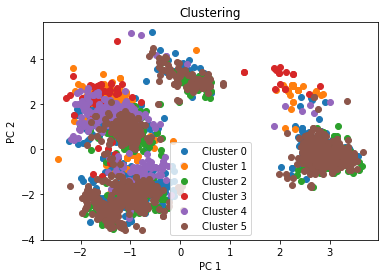

In [ ]:
k = 6 # according to elbow method
KM = KMeans(n_clusters=k)
KM.fit(X)
y_hat_Kmeans = KM.predict(X)
print(silhouette_score(X, y_hat_Kmeans))
       

for i in range(k):
    plt.scatter(X_pca[y_hat_Kmeans == i, 0], X_pca[y_hat_Kmeans == i, 1], label=f'Cluster {i}')
plt.legend()
plt.xlabel('PC 1')
plt.ylabel('PC 2')
plt.title("Clustering")
plt.show()

###  PCA - K-means
The K-means algorithm is performing very similar in the PCA plot as the  hierachical clustering, where we see clusters that appear in both of the group of observations in 2D. 

## Optimal model:

The final optimal model chosen for furhter analysis based on the elbow method and sihuette score. The purpose of this analysis was to discover overall pattern with as few clusters as possible. As we see in both of the clustering methods, they suggest k = 6 which is the number clusters we will continue the following analysis on. 

#### How is the Variables distributed with regards to clusters? 

In order to gain insight of the different clusters with regards to price, location and crime occourance we will need to do some data_analysis on the labels of different clustering methods

In [ ]:
X['K-means'] = y_hat_Kmeans
X['Hierachical'] = y_hat_H

In [ ]:
X.head()

,Latitude,Longitude,SALE PRICE,ZIP CODE,LAND SQUARE FEET,GROSS SQUARE FEET,AMERICAN INDIAN/ALASKAN NATIVE,ASIAN / PACIFIC ISLANDER,BLACK,BLACK HISPANIC,...,ASSAULT 3 & RELATED OFFENSES,FELONY ASSAULT,ROBBERY,BRONX,BROOKLYN,MANHATTAN,QUEENS,RICHMOND / STATEN ISLAND,K-means,Hierachical
128037,40.90,-73.85,800000,10466.0,2910.0,2907.0,0,0,0,1,...,1,0,0,1,0,0,0,0,0,5
267336,40.73,-73.87,658000,11379.0,2425.0,1056.0,0,0,0,0,...,1,0,0,0,0,0,1,0,5,1
312201,40.84,-73.89,217000,10460.0,1750.0,992.0,0,0,0,1,...,1,0,0,1,0,0,0,0,2,2
371403,40.84,-73.90,505000,10457.0,2000.0,2400.0,0,0,0,1,...,1,0,0,1,0,0,0,0,5,1
73349,40.68,-73.91,1395000,11233.0,1575.0,1892.0,0,0,1,0,...,1,0,0,0,1,0,0,0,4,4


### Prices

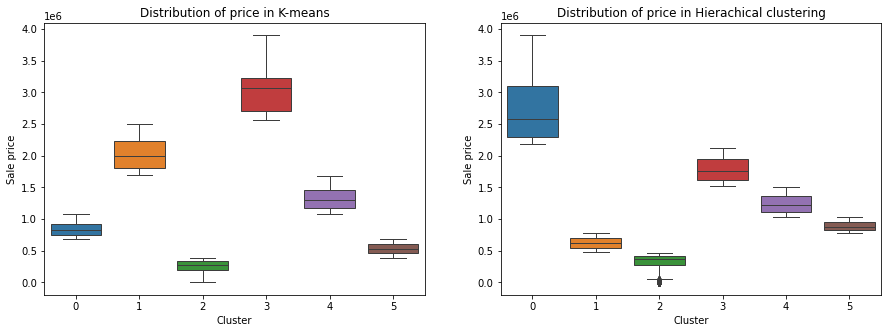

In [ ]:
fig, axes = plt.subplots(1, 2, sharex=True, figsize=(15,5))
#plt.subplots(sharex=True, figsize=(5,7))
sns.boxplot(ax=axes[0],x="K-means", y="SALE PRICE", data=X, order=[0,1,2,3,4,5],linewidth=1)
axes[0].set_title("Distribution of price in K-means")
axes[0].set(xlabel='Cluster', ylabel="Sale price")


sns.boxplot(ax=axes[1],x="Hierachical", y="SALE PRICE", data=X, order=[0,1,2,3,4,5],linewidth=1)
axes[1].set_title("Distribution of price in Hierachical clustering")
axes[1].set(xlabel='Cluster', ylabel="Sale price")
plt.savefig("box_plot_price_cluster.png")


#### Price difference
From the box plots, we see that the price difference is very clear between each clusters. The most interesting clusters are the one with the smallest and the largest prices. 
While the different methods has similar sihuette score, and they also have similar clusters (only name differs)

In [ ]:
#finding the most expensive and cheapest index for clusters:
minidx = X.groupby('K-means')['SALE PRICE'].mean().idxmin()
maxidx = X.groupby('K-means')['SALE PRICE'].mean().idxmax()

minidxH = X.groupby('Hierachical')['SALE PRICE'].mean().idxmin()
maxidxH = X.groupby('Hierachical')['SALE PRICE'].mean().idxmax()

#### Box plot of prices: 

In [ ]:
print(f'From the prices, It is clear that the price distribution for both of the models gives the same result.' )
print(f'The cluster containing the cheapest houses is cluster {minidx} for K-means.' )
print(f'The cluster containing the cheapest houses is cluster {minidxH} for hierachical clustering.' )

print(f'The cluster containing the most expensive houses is cluster {maxidx} for K-means.' )
print(f'The cluster containing the most expensive houses is cluster {maxidxH} for hierachical clustering.' )


From the prices, It is clear that the price distribution for both of the models gives the same result.
The cluster containing the cheapest houses is cluster 2 for K-means.
The cluster containing the cheapest houses is cluster 2 for hierachical clustering.
The cluster containing the most expensive houses is cluster 3 for K-means.
The cluster containing the most expensive houses is cluster 0 for hierachical clustering.


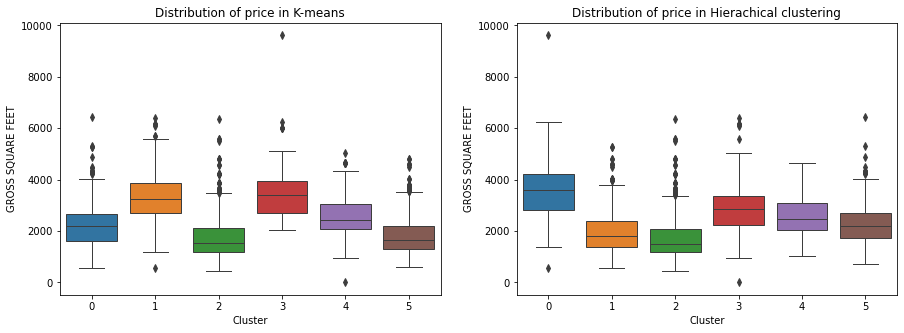

In [ ]:
fig, axes = plt.subplots(1, 2, sharex=True, figsize=(15,5))

sns.boxplot(ax=axes[0],x="K-means", y="GROSS SQUARE FEET", data=X, order=[0,1,2,3,4,5],linewidth=1)
axes[0].set_title("Distribution of price in K-means")
axes[0].set(xlabel='Cluster', ylabel="GROSS SQUARE FEET")

sns.boxplot(ax=axes[1],x="Hierachical", y="GROSS SQUARE FEET", data=X, order=[0,1,2,3,4,5],linewidth=1)
axes[1].set_title("Distribution of price in Hierachical clustering")
axes[1].set(xlabel='Cluster', ylabel="GROSS SQUARE FEET")

plt.savefig("box_plot_size_cluster.png")


#### House size in different clusters.
This box plot sows that the difference between each cluster wirh regards to gross square feet is not significantly large. Which could indicate that it should be possible to get a wide range of house size within each cluster.


### Zip codes
It will be interesting to look at the distribution of zip codes in each cluster, if location is a variable that separates the clusters.


Text(0.5, 1.0, 'Hierachical clustering')

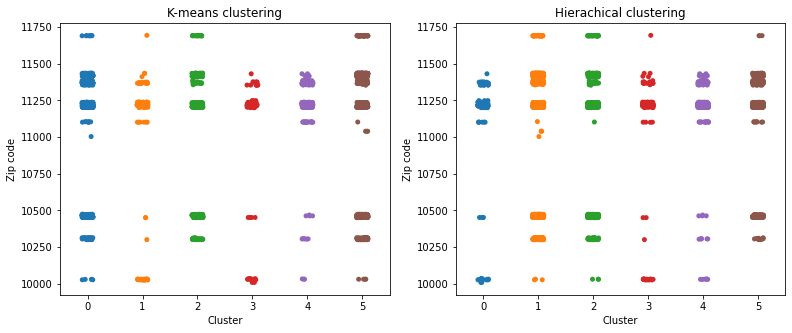

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(13,5))
#sns.boxplot(x="K-means", y="SALE PRICE", data=X, order=[0],linewidth=1,showfliers = False)
sns.stripplot(x="K-means", y='ZIP CODE', data=X, ax=axes[0]).set(xlabel='Cluster', ylabel="Zip code")
axes[0].set_title("K-means clustering")
sns.stripplot(x="Hierachical", y='ZIP CODE', data=X, ax=axes[1]).set(xlabel='Cluster', ylabel="Zip code")
axes[1].set_title("Hierachical clustering")

#### Distribution of zip codes: 

Again, both method are very similar, the only visible difference is the order of the cluster names. 

Looking at the distribution of zip codes, we see that there are some zip codes that occurs within some of the custers. The most "expensive" clusters shows that they occur in similar locations, which could tend to be that there's not a lot of zip codes that belongs to the "expensive" cluster. 

From the zip code plot, we see that the zip code in in k-means clusters are slightly different from clusters in hierachical clustering. e.g. even if clusters are similar in price, it has different areas. 
From this point on, we will only use k-means as there's no big difference between the clustering methods.

### Boroughs

In [ ]:
concatdf= X[ (X['K-means']==minidx) | (X['K-means']==maxidx)]
labels=["Cheapest cluster", "Most expensive cluster"]
concatdf["K-means"] = concatdf["K-means"].map(dict(zip([minidx,maxidx], labels)))

In [ ]:
# go back from one hot encode
concatdf.loc[ concatdf['BRONX'] ==1, 'boroughs'] = 'BRONX'
concatdf.loc[ concatdf['MANHATTAN'] ==1, 'boroughs'] = 'MANHATTAN'
concatdf.loc[ concatdf['BROOKLYN'] ==1, 'boroughs'] = 'BROOKLYN'
concatdf.loc[ concatdf['QUEENS'] ==1, 'boroughs'] = 'QUEENS'
concatdf.loc[ concatdf['RICHMOND / STATEN ISLAND'] ==1, 'boroughs'] = 'RICHMOND / STATEN ISLAND'

In [ ]:
cross = pd.crosstab(index=concatdf['boroughs'], columns=concatdf['K-means'])
cross_stand = cross/cross.sum()
stacked = cross_stand.stack().reset_index().rename(columns={0:'occurrence in %'})

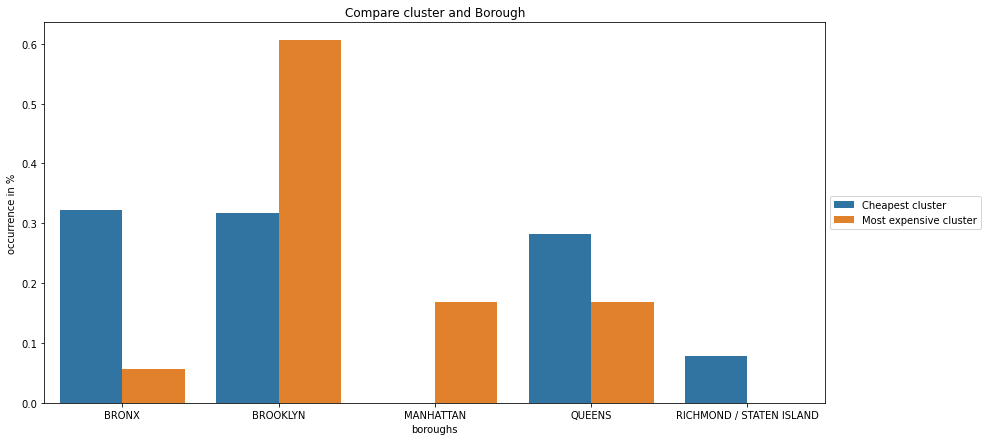

In [ ]:
plt.figure(figsize=(14, 7))
g=sns.barplot(x=stacked.boroughs, y=stacked['occurrence in %'], hue=stacked['K-means'])
g.set_title("Compare cluster and Borough")
g.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.savefig("bar_chart_cluster_borough.png")

#### Bar chart: 
This bar chart shows that cluster 5 from k-means which is the most expensive cluster, it has large frequency in Brooklyn and non in Richmond/ staten Island. 
The cheapest cluster is 3 which has high occurence % in Bronx and and Queen, and close to non in Manhattan.

### Crimes

In [ ]:
concatdf_H = X[ (X['K-means']==minidx) | (X['K-means']==maxidx)]
labels=["Cheapest cluster", "Most expensive cluster"]

concatdf_H["K-means"] = concatdf_H["K-means"].map(dict(zip([minidx,maxidx], labels)))


In [ ]:
# go back from one hot encode
concatdf_H.loc[ concatdf_H['FELONY ASSAULT'] ==1, 'crime'] = 'FELONY ASSAULT'
concatdf_H.loc[ concatdf_H['ASSAULT 3 & RELATED OFFENSES'] ==1, 'crime'] = 'ASSAULT 3 & RELATED OFFENSES'
concatdf_H.loc[ concatdf_H['ROBBERY'] ==1, 'crime'] = 'ROBBERY'

In [ ]:
cross_crime = pd.crosstab(index=concatdf_H['crime'], columns=concatdf_H['K-means'])
cross_stand_crime = cross_crime/cross_crime.sum()
stacked_crime = cross_stand_crime.stack().reset_index().rename(columns={0:'occurrence in %'})

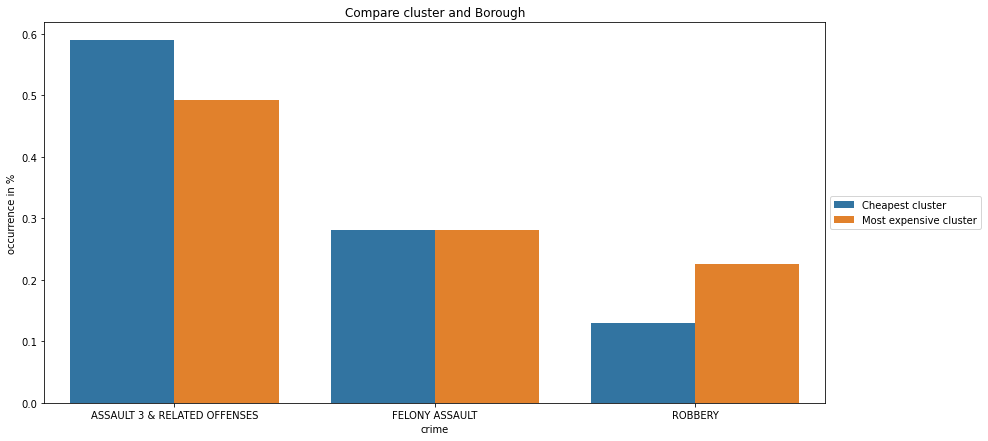

In [ ]:
plt.figure(figsize=(14, 7))
g=sns.barplot(x=stacked_crime.crime, y=stacked_crime['occurrence in %'], hue=stacked_crime['K-means'])
g.set_title("Compare cluster and Borough")
g.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.savefig("bar_chart_cluster_crime.png")

## All clusters comparing 

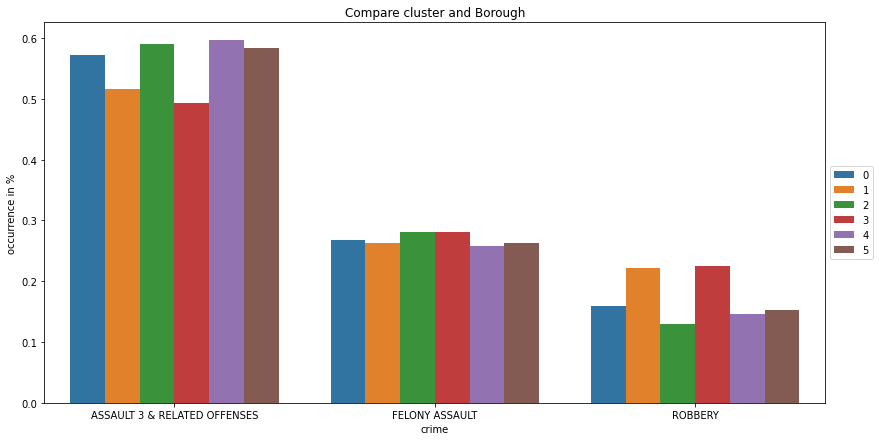

In [ ]:
X.loc[ X['FELONY ASSAULT'] ==1, 'crime'] = 'FELONY ASSAULT'
X.loc[ X['ASSAULT 3 & RELATED OFFENSES'] ==1, 'crime'] = 'ASSAULT 3 & RELATED OFFENSES'
X.loc[ X['ROBBERY'] ==1, 'crime'] = 'ROBBERY'
cross_crime_all = pd.crosstab(index=X['crime'], columns=X['K-means'])
cross_stand_crime_all = cross_crime_all/cross_crime_all.sum()
stacked_crime_all = cross_stand_crime_all.stack().reset_index().rename(columns={0:'occurrence in %'})


plt.figure(figsize=(14, 7))
g=sns.barplot(x=stacked_crime_all.crime, y=stacked_crime_all['occurrence in %'], hue=stacked_crime_all['K-means'])
g.set_title("Compare cluster and Borough")
g.legend(loc='center left', bbox_to_anchor=(1, 0.5))

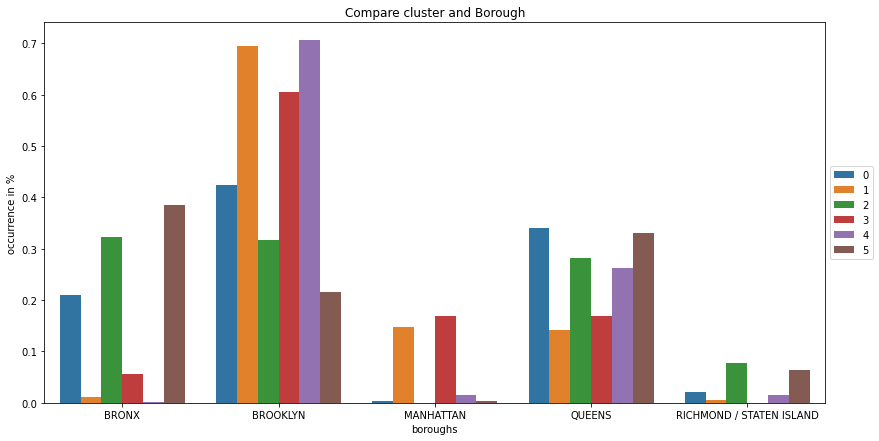

In [ ]:
# go back from one hot encode
X.loc[ X['BRONX'] ==1, 'boroughs'] = 'BRONX'
X.loc[ X['MANHATTAN'] ==1, 'boroughs'] = 'MANHATTAN'
X.loc[ X['BROOKLYN'] ==1, 'boroughs'] = 'BROOKLYN'
X.loc[ X['QUEENS'] ==1, 'boroughs'] = 'QUEENS'
X.loc[ X['RICHMOND / STATEN ISLAND'] ==1, 'boroughs'] = 'RICHMOND / STATEN ISLAND'




cross_b_all = pd.crosstab(index=X['boroughs'], columns=X['K-means'])
cross_stand_b_all = cross_b_all/cross_b_all.sum()
stacked_b_all = cross_stand_b_all.stack().reset_index().rename(columns={0:'occurrence in %'})


plt.figure(figsize=(14, 7))
g=sns.barplot(x=stacked_b_all['boroughs'], y=stacked_b_all['occurrence in %'], hue=stacked_b_all['K-means'])
g.set_title("Compare cluster and Borough")
g.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.savefig("bar_char_all_cluster.png")


#### Bar chart
The distribution of boroughs in the different clusters. As it is shown here, some clusters have very few number of observations in Bronx, Manhattan and Richmond, while almost all clusters have high numbers of houses for sale in Brooklyn. 

# Discussion and conclusion 
 
The aim of the project was enlightening the different parameters taken into account when one person is looking for a place to live.In general, we were able to extract the most interesting features for each of the data set
The key interest variables from house data are location (zip code, boroughs), size of residence and prices. This data contained not only residents to live, but also office building, storage etc. which is then filtered out. 
The crime data contains different interesting patterns such as the number of arrests in each precinct is more common in some areas where prices are low.  Binning the data into boroughs tends to lose information. Therefore map is the best visualization tool for this. Although for some cases we chose to plot some crime types according to borough, as it has fewer categories compared to precinct therefore easier to formulate on the website. 
The arrest data has no zip code variable, instead it contains precinct, which covers over more zip codes , which makes the maps unable to compare 1:1. 

Lastly, after using k-means clustering, the merged data (contains key variables from both data sets) were able to clarify some information about living in NY. The clusters showed no significant difference in size of living space, while clearly they had a difference in price. Number of occurence of 3 interest crimes also shows a slight difference, where the cheaper area is less prone for robbery. 

There are different ways to merge two data frames, in this project, we chose to use the locational variables, such as borough. After some investigation, we decided to use longitude and latitude, which was more describing locational parameters, also it has improved the performance of our clustering algorithm.

When merging the data for further data analysis the overall data frame becomes very large, which was the reason we had to down sample our data in order to avoid kernel errors.
 
The house sales data that has been used only contained observations from 2018 to 2019, but the data has been updated on the website, so it now contains observations from 2016. Since we have been limited with the time, unable to redo the analysis, it might have helped improve the performance. Also, due to limited computational power, we are unable to add more data to the current clustering methods. But by adding more data from different time periods might have given more nuance to the visualizations.


# Future work:
 
If possible, it would also have been interesting to look into some other machine learning models, for instance implement and train a classifier that could suggest an area, zip code etc. based on user inputs such as salary, age etc. This will also require that we will need to expand the data set to include more social democratic information.

# Reference:
[1] “The impact of crime on property values: Research roundup”
https://journalistsresource.org/economics/the-impact-of-crime-on-property-values-research-roundup/,(access:14.05.2021).

## Contributions
House sale: Line 

Arrest: Yue 

Machine learning: Jiayi 

Website: Line, Yue, Jiayi 

(In reality did we all contributed equally to each part)
